In [4]:
import seaborn as sns
sns.set(style='darkgrid')
import warnings
warnings.filterwarnings('ignore')

In [8]:
import tensorflow as tf

from tensorflow.keras import datasets, layers, models
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator

import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow import keras

In [6]:
from PIL import Image
num_skipped = 0

for folder_name in ("cat", "dog", "elephant", "horse", "lion"):
    for abb in ("animals/train", "animals/val" ):
        folder_path = os.path.join(abb, folder_name)
        for fname in os.listdir(folder_path):
            fpath = os.path.join(folder_path, fname)
            if fname.endswith('.jpg') or fname.endswith('.jpeg'):
                try:
                    img = Image.open(fpath) # open the image file
                    #print("%s", fpath)
                    exif_data = img._getexif()
                    img.verify() # verify that it is, in fact an image
                except:
                    num_skipped += 1
                    # Delete corrupted image
                    os.remove(fpath)
print("PIL deleted %d images" % num_skipped)

PIL deleted 0 images


In [446]:
# import os
# 
# num_skipped = 0
# for folder_name in ("cat", "dog", "elephant", "horse", "lion"):
#     for abb in ("animals/train", "animals/val"):
#         folder_path = os.path.join(abb, folder_name)
#         for fname in os.listdir(folder_path):
#                 # print(fname) # <---- add this
#                 fpath = os.path.join(folder_path, fname)
#                 try:
#                     fobj = open(fpath, "rb")
#                     is_jfif = tf.compat.as_bytes("JFIF") in fobj.peek(10)
#                 finally:
#                     fobj.close()
# 
#                 if not is_jfif:
#                     num_skipped += 1
#                     # Delete corrupted image
#                     os.remove(fpath)
# 
# print("Deleted %d images" % num_skipped)

In [447]:
testeo_dir ='animals/val'

test_images = ImageDataGenerator(rescale= 1./255)
batch_size = 128
test_X = tf.keras.utils.image_dataset_from_directory(batch_size = batch_size, directory = testeo_dir)

Found 3319 files belonging to 5 classes.


In [448]:
test_X.class_names

['cat', 'dog', 'elephant', 'horse', 'lion']

In [449]:
train_dir = 'animals/train'
validation_dir = 'animals/val'
test_dir = 'animals/inf'

total_train = sum([len(files) for r, d, files in os.walk(train_dir)])
total_val = sum([len(files) for r, d, files in os.walk(validation_dir)])
total_test = len(os.listdir(test_dir))
print(total_test, total_train, total_val)
batch_size = 128
epochs = 15
IMG_HEIGHT = 150
IMG_WIDTH = 150

5 39047 3324


In [450]:
train_image_generator = ImageDataGenerator(1./225)
validation_image_generator = ImageDataGenerator(rescale= 1./255)
test_image_generator = ImageDataGenerator(rescale= 1./255)

train_data_gen = tf.keras.utils.image_dataset_from_directory(batch_size = batch_size,
                                                          directory = train_dir, image_size=(IMG_HEIGHT, IMG_WIDTH) )
val_data_gen = tf.keras.utils.image_dataset_from_directory(batch_size = batch_size,
                                                           directory = validation_dir,image_size=(IMG_HEIGHT, IMG_WIDTH))
# test_data_gen = tf.keras.utils.image_dataset_from_directory(batch_size = batch_size, directory = test_dir,  shuffle = False)

Found 39042 files belonging to 5 classes.
Found 3319 files belonging to 5 classes.


In [451]:
class_names = train_data_gen.class_names

In [452]:
val_data_gen.class_names

['cat', 'dog', 'elephant', 'horse', 'lion']

2024-06-02 22:26:17.397919: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


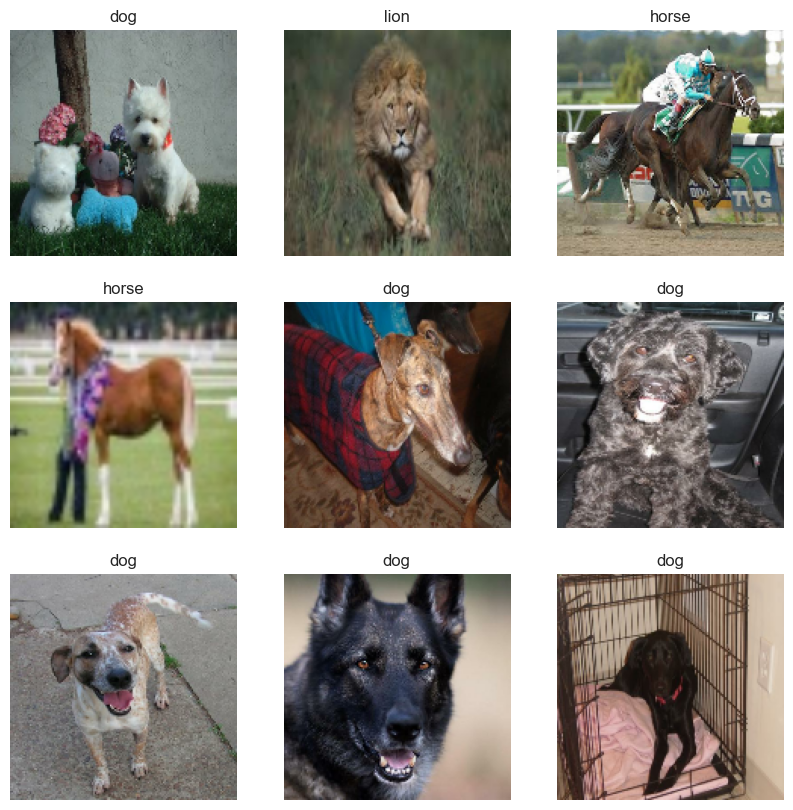

In [453]:
plt.figure(figsize=(10, 10))
for images, labels in train_data_gen.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [454]:
train_image_generator = ImageDataGenerator(rescale= 1./255,
                                           rotation_range = 45,
                                           shear_range = 0.2,
                                           zoom_range = 0.2,
                                           horizontal_flip = True,
                                           vertical_flip = True,
                                           validation_split = .2)

In [1]:
train_data_gen = tf.keras.utils.image_dataset_from_directory(batch_size=batch_size,
                                                     directory=train_dir,
                                                     image_size=(150, 150))

augmented_images = [train_data_gen[0][0][0] for i in range(5)]

plotImages(augmented_images)

NameError: name 'tf' is not defined

In [456]:
num_classes = len(class_names)

model = models.Sequential()
model.add(layers.Conv2D(16, (3, 3), activation='relu', input_shape=(IMG_HEIGHT, IMG_WIDTH, 3)))
model.add(layers.MaxPooling2D(2,2))
model.add(layers.Conv2D(32, (3,3), activation="relu"))
model.add(layers.MaxPooling2D(2,2))
model.add(layers.Conv2D(64, (3,3), activation="relu"))
model.add(layers.MaxPooling2D(2,2))
model.add(layers.Conv2D(128, (3,3), activation="relu"))
model.add(layers.MaxPooling2D(2,2))




model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dense(num_classes))

model.compile(optimizer= "adam",
              loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics= ["accuracy"])

model.summary()

Model: "sequential_40"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_110 (Conv2D)             │ (None, 148, 148, 16)   │           448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_110               │ (None, 74, 74, 16)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_111 (Conv2D)             │ (None, 72, 72, 32)     │         4,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_111               │ (None, 36, 36, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_112 (Conv2D)             │ (None, 34, 34, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_112               │ (None, 17, 17, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_113 (Conv2D)             │ (None, 15, 15, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_113               │ (None, 7, 7, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_30 (Flatten)            │ (None, 6272)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (None, 128)            │       802,944 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (None, 5)              │           645 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 901,029 (3.44 MB)

 Trainable params: 901,029 (3.44 MB)

 Non-trainable params: 0 (0.00 B)

In [457]:
history = model.fit(x=train_data_gen, epochs=10,
                    validation_data=val_data_gen, validation_steps=total_val//batch_size)

Epoch 1/10
 10/306 ━━━━━━━━━━━━━━━━━━━━ 1:40 339ms/step - accuracy: 0.3010 - loss: 45.7514

Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 52/306 ━━━━━━━━━━━━━━━━━━━━ 1:33 369ms/step - accuracy: 0.3352 - loss: 17.9579

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 55/306 ━━━━━━━━━━━━━━━━━━━━ 1:33 372ms/step - accuracy: 0.3373 - loss: 17.3154

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 67/306 ━━━━━━━━━━━━━━━━━━━━ 1:30 379ms/step - accuracy: 0.3457 - loss: 15.2153

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


100/306 ━━━━━━━━━━━━━━━━━━━━ 1:15 368ms/step - accuracy: 0.3678 - loss: 11.6605

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


125/306 ━━━━━━━━━━━━━━━━━━━━ 1:06 370ms/step - accuracy: 0.3819 - loss: 10.0441

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


141/306 ━━━━━━━━━━━━━━━━━━━━ 1:00 366ms/step - accuracy: 0.3899 - loss: 9.2675

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


173/306 ━━━━━━━━━━━━━━━━━━━━ 48s 362ms/step - accuracy: 0.4044 - loss: 8.0857

191/306 ━━━━━━━━━━━━━━━━━━━━ 41s 360ms/step - accuracy: 0.4118 - loss: 7.5708

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


201/306 ━━━━━━━━━━━━━━━━━━━━ 37s 360ms/step - accuracy: 0.4157 - loss: 7.3190

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


202/306 ━━━━━━━━━━━━━━━━━━━━ 37s 361ms/step - accuracy: 0.4160 - loss: 7.2950

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


260/306 ━━━━━━━━━━━━━━━━━━━━ 16s 354ms/step - accuracy: 0.4358 - loss: 6.1788

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


277/306 ━━━━━━━━━━━━━━━━━━━━ 10s 352ms/step - accuracy: 0.4408 - loss: 5.9289

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 110s 357ms/step - accuracy: 0.4490 - loss: 5.5468 - val_accuracy: 0.4663 - val_loss: 1.4096
Epoch 2/10


Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 23/306 ━━━━━━━━━━━━━━━━━━━━ 1:29 315ms/step - accuracy: 0.5436 - loss: 1.1587

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 40/306 ━━━━━━━━━━━━━━━━━━━━ 1:23 313ms/step - accuracy: 0.5638 - loss: 1.1053

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 51/306 ━━━━━━━━━━━━━━━━━━━━ 1:20 314ms/step - accuracy: 0.5725 - loss: 1.0824

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 86/306 ━━━━━━━━━━━━━━━━━━━━ 1:09 316ms/step - accuracy: 0.5896 - loss: 1.0410

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


138/306 ━━━━━━━━━━━━━━━━━━━━ 53s 319ms/step - accuracy: 0.6038 - loss: 1.0079

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


139/306 ━━━━━━━━━━━━━━━━━━━━ 53s 319ms/step - accuracy: 0.6040 - loss: 1.0074

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


173/306 ━━━━━━━━━━━━━━━━━━━━ 42s 319ms/step - accuracy: 0.6103 - loss: 0.9921

195/306 ━━━━━━━━━━━━━━━━━━━━ 35s 319ms/step - accuracy: 0.6138 - loss: 0.9836

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


202/306 ━━━━━━━━━━━━━━━━━━━━ 33s 319ms/step - accuracy: 0.6148 - loss: 0.9811

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


208/306 ━━━━━━━━━━━━━━━━━━━━ 31s 319ms/step - accuracy: 0.6156 - loss: 0.9791

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


246/306 ━━━━━━━━━━━━━━━━━━━━ 19s 320ms/step - accuracy: 0.6203 - loss: 0.9679

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


263/306 ━━━━━━━━━━━━━━━━━━━━ 13s 319ms/step - accuracy: 0.6223 - loss: 0.9634

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 97s 318ms/step - accuracy: 0.6268 - loss: 0.9529 - val_accuracy: 0.4538 - val_loss: 1.3356
Epoch 3/10


2024-06-02 22:29:46.750374: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]


 19/306 ━━━━━━━━━━━━━━━━━━━━ 1:30 317ms/step - accuracy: 0.5503 - loss: 1.1523

Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 33/306 ━━━━━━━━━━━━━━━━━━━━ 1:25 314ms/step - accuracy: 0.5537 - loss: 1.1299

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 45/306 ━━━━━━━━━━━━━━━━━━━━ 1:21 313ms/step - accuracy: 0.5611 - loss: 1.1075

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 47/306 ━━━━━━━━━━━━━━━━━━━━ 1:20 313ms/step - accuracy: 0.5625 - loss: 1.1037

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 91/306 ━━━━━━━━━━━━━━━━━━━━ 1:08 317ms/step - accuracy: 0.5865 - loss: 1.0448

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


125/306 ━━━━━━━━━━━━━━━━━━━━ 57s 316ms/step - accuracy: 0.5991 - loss: 1.0145

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


150/306 ━━━━━━━━━━━━━━━━━━━━ 49s 316ms/step - accuracy: 0.6064 - loss: 0.9968

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


172/306 ━━━━━━━━━━━━━━━━━━━━ 42s 315ms/step - accuracy: 0.6122 - loss: 0.9825

202/306 ━━━━━━━━━━━━━━━━━━━━ 32s 316ms/step - accuracy: 0.6188 - loss: 0.9661

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


206/306 ━━━━━━━━━━━━━━━━━━━━ 31s 316ms/step - accuracy: 0.6196 - loss: 0.9641

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


229/306 ━━━━━━━━━━━━━━━━━━━━ 24s 317ms/step - accuracy: 0.6241 - loss: 0.9533

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


255/306 ━━━━━━━━━━━━━━━━━━━━ 16s 317ms/step - accuracy: 0.6287 - loss: 0.9423

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


263/306 ━━━━━━━━━━━━━━━━━━━━ 13s 317ms/step - accuracy: 0.6300 - loss: 0.9392

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 99s 324ms/step - accuracy: 0.6366 - loss: 0.9233 - val_accuracy: 0.7044 - val_loss: 0.7996
Epoch 4/10
 10/306 ━━━━━━━━━━━━━━━━━━━━ 1:36 324ms/step - accuracy: 0.6851 - loss: 0.8126

Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 36/306 ━━━━━━━━━━━━━━━━━━━━ 1:27 325ms/step - accuracy: 0.7157 - loss: 0.7584

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 46/306 ━━━━━━━━━━━━━━━━━━━━ 1:24 324ms/step - accuracy: 0.7193 - loss: 0.7490

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 54/306 ━━━━━━━━━━━━━━━━━━━━ 1:21 323ms/step - accuracy: 0.7214 - loss: 0.7439

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 92/306 ━━━━━━━━━━━━━━━━━━━━ 1:08 321ms/step - accuracy: 0.7258 - loss: 0.7292

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


126/306 ━━━━━━━━━━━━━━━━━━━━ 57s 319ms/step - accuracy: 0.7284 - loss: 0.7192

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


146/306 ━━━━━━━━━━━━━━━━━━━━ 50s 318ms/step - accuracy: 0.7296 - loss: 0.7145

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


173/306 ━━━━━━━━━━━━━━━━━━━━ 42s 320ms/step - accuracy: 0.7311 - loss: 0.7091

193/306 ━━━━━━━━━━━━━━━━━━━━ 36s 319ms/step - accuracy: 0.7322 - loss: 0.7055

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


203/306 ━━━━━━━━━━━━━━━━━━━━ 32s 319ms/step - accuracy: 0.7327 - loss: 0.7038

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


227/306 ━━━━━━━━━━━━━━━━━━━━ 25s 319ms/step - accuracy: 0.7340 - loss: 0.7000

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


253/306 ━━━━━━━━━━━━━━━━━━━━ 16s 319ms/step - accuracy: 0.7354 - loss: 0.6960

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


282/306 ━━━━━━━━━━━━━━━━━━━━ 7s 319ms/step - accuracy: 0.7367 - loss: 0.6918

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 98s 319ms/step - accuracy: 0.7379 - loss: 0.6883 - val_accuracy: 0.6639 - val_loss: 0.8812
Epoch 5/10


2024-06-02 22:33:03.646221: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 23/306 ━━━━━━━━━━━━━━━━━━━━ 1:29 316ms/step - accuracy: 0.7578 - loss: 0.6336

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 41/306 ━━━━━━━━━━━━━━━━━━━━ 1:23 313ms/step - accuracy: 0.7660 - loss: 0.6162

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 49/306 ━━━━━━━━━━━━━━━━━━━━ 1:20 315ms/step - accuracy: 0.7673 - loss: 0.6130

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 84/306 ━━━━━━━━━━━━━━━━━━━━ 1:09 315ms/step - accuracy: 0.7707 - loss: 0.6065

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


123/306 ━━━━━━━━━━━━━━━━━━━━ 57s 316ms/step - accuracy: 0.7739 - loss: 0.5999

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


146/306 ━━━━━━━━━━━━━━━━━━━━ 50s 318ms/step - accuracy: 0.7752 - loss: 0.5968

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


178/306 ━━━━━━━━━━━━━━━━━━━━ 40s 318ms/step - accuracy: 0.7767 - loss: 0.5922

194/306 ━━━━━━━━━━━━━━━━━━━━ 35s 317ms/step - accuracy: 0.7774 - loss: 0.5902

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


202/306 ━━━━━━━━━━━━━━━━━━━━ 33s 318ms/step - accuracy: 0.7777 - loss: 0.5893

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9
Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


251/306 ━━━━━━━━━━━━━━━━━━━━ 17s 317ms/step - accuracy: 0.7796 - loss: 0.5844

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


259/306 ━━━━━━━━━━━━━━━━━━━━ 14s 317ms/step - accuracy: 0.7799 - loss: 0.5836

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 99s 325ms/step - accuracy: 0.7814 - loss: 0.5795 - val_accuracy: 0.6159 - val_loss: 1.1741
Epoch 6/10


Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 23/306 ━━━━━━━━━━━━━━━━━━━━ 1:31 322ms/step - accuracy: 0.6458 - loss: 0.9690

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 47/306 ━━━━━━━━━━━━━━━━━━━━ 1:22 320ms/step - accuracy: 0.6700 - loss: 0.8916

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 57/306 ━━━━━━━━━━━━━━━━━━━━ 1:19 319ms/step - accuracy: 0.6782 - loss: 0.8669

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


121/306 ━━━━━━━━━━━━━━━━━━━━ 59s 321ms/step - accuracy: 0.7141 - loss: 0.7619

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


125/306 ━━━━━━━━━━━━━━━━━━━━ 58s 321ms/step - accuracy: 0.7157 - loss: 0.7573

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


144/306 ━━━━━━━━━━━━━━━━━━━━ 51s 320ms/step - accuracy: 0.7227 - loss: 0.7379

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


172/306 ━━━━━━━━━━━━━━━━━━━━ 42s 319ms/step - accuracy: 0.7311 - loss: 0.7141

197/306 ━━━━━━━━━━━━━━━━━━━━ 34s 318ms/step - accuracy: 0.7373 - loss: 0.6969

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


198/306 ━━━━━━━━━━━━━━━━━━━━ 34s 318ms/step - accuracy: 0.7375 - loss: 0.6963

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


216/306 ━━━━━━━━━━━━━━━━━━━━ 28s 318ms/step - accuracy: 0.7414 - loss: 0.6856

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


245/306 ━━━━━━━━━━━━━━━━━━━━ 19s 320ms/step - accuracy: 0.7469 - loss: 0.6704

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


290/306 ━━━━━━━━━━━━━━━━━━━━ 5s 319ms/step - accuracy: 0.7543 - loss: 0.6502

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 97s 318ms/step - accuracy: 0.7568 - loss: 0.6435 - val_accuracy: 0.6975 - val_loss: 0.9080
Epoch 7/10


2024-06-02 22:36:20.465126: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]


  9/306 ━━━━━━━━━━━━━━━━━━━━ 1:33 315ms/step - accuracy: 0.8100 - loss: 0.5695

Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 45/306 ━━━━━━━━━━━━━━━━━━━━ 1:21 312ms/step - accuracy: 0.8058 - loss: 0.5386

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 46/306 ━━━━━━━━━━━━━━━━━━━━ 1:21 312ms/step - accuracy: 0.8060 - loss: 0.5378

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 59/306 ━━━━━━━━━━━━━━━━━━━━ 1:17 312ms/step - accuracy: 0.8084 - loss: 0.5283

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 99/306 ━━━━━━━━━━━━━━━━━━━━ 1:06 319ms/step - accuracy: 0.8142 - loss: 0.5070

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


139/306 ━━━━━━━━━━━━━━━━━━━━ 53s 318ms/step - accuracy: 0.8189 - loss: 0.4922

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


141/306 ━━━━━━━━━━━━━━━━━━━━ 52s 318ms/step - accuracy: 0.8190 - loss: 0.4916

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


180/306 ━━━━━━━━━━━━━━━━━━━━ 40s 318ms/step - accuracy: 0.8227 - loss: 0.4802

195/306 ━━━━━━━━━━━━━━━━━━━━ 35s 319ms/step - accuracy: 0.8240 - loss: 0.4763

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


205/306 ━━━━━━━━━━━━━━━━━━━━ 32s 321ms/step - accuracy: 0.8248 - loss: 0.4738

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


216/306 ━━━━━━━━━━━━━━━━━━━━ 28s 320ms/step - accuracy: 0.8256 - loss: 0.4713

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


260/306 ━━━━━━━━━━━━━━━━━━━━ 14s 325ms/step - accuracy: 0.8283 - loss: 0.4629

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


291/306 ━━━━━━━━━━━━━━━━━━━━ 4s 327ms/step - accuracy: 0.8301 - loss: 0.4577

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 103s 335ms/step - accuracy: 0.8309 - loss: 0.4553 - val_accuracy: 0.5838 - val_loss: 1.5167
Epoch 8/10
  2/306 ━━━━━━━━━━━━━━━━━━━━ 1:50 363ms/step - accuracy: 0.6094 - loss: 1.1742

Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 26/306 ━━━━━━━━━━━━━━━━━━━━ 1:38 351ms/step - accuracy: 0.5990 - loss: 1.1241

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 49/306 ━━━━━━━━━━━━━━━━━━━━ 1:25 333ms/step - accuracy: 0.6369 - loss: 0.9953

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 60/306 ━━━━━━━━━━━━━━━━━━━━ 1:21 330ms/step - accuracy: 0.6516 - loss: 0.9503

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 86/306 ━━━━━━━━━━━━━━━━━━━━ 1:12 329ms/step - accuracy: 0.6786 - loss: 0.8704

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


126/306 ━━━━━━━━━━━━━━━━━━━━ 58s 325ms/step - accuracy: 0.7089 - loss: 0.7844

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


145/306 ━━━━━━━━━━━━━━━━━━━━ 52s 327ms/step - accuracy: 0.7197 - loss: 0.7537

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


179/306 ━━━━━━━━━━━━━━━━━━━━ 41s 326ms/step - accuracy: 0.7357 - loss: 0.7089

198/306 ━━━━━━━━━━━━━━━━━━━━ 35s 326ms/step - accuracy: 0.7432 - loss: 0.6882

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


206/306 ━━━━━━━━━━━━━━━━━━━━ 32s 327ms/step - accuracy: 0.7461 - loss: 0.6803

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


211/306 ━━━━━━━━━━━━━━━━━━━━ 31s 326ms/step - accuracy: 0.7478 - loss: 0.6755

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


256/306 ━━━━━━━━━━━━━━━━━━━━ 16s 325ms/step - accuracy: 0.7614 - loss: 0.6383

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


264/306 ━━━━━━━━━━━━━━━━━━━━ 13s 325ms/step - accuracy: 0.7635 - loss: 0.6326

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 99s 322ms/step - accuracy: 0.7736 - loss: 0.6049 - val_accuracy: 0.7143 - val_loss: 1.2427
Epoch 9/10


2024-06-02 22:39:41.987703: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]


  7/306 ━━━━━━━━━━━━━━━━━━━━ 1:36 322ms/step - accuracy: 0.7582 - loss: 0.7657

Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 33/306 ━━━━━━━━━━━━━━━━━━━━ 1:30 333ms/step - accuracy: 0.7583 - loss: 0.6860

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 47/306 ━━━━━━━━━━━━━━━━━━━━ 1:25 329ms/step - accuracy: 0.7666 - loss: 0.6510

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 51/306 ━━━━━━━━━━━━━━━━━━━━ 1:23 329ms/step - accuracy: 0.7690 - loss: 0.6423

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 89/306 ━━━━━━━━━━━━━━━━━━━━ 1:10 323ms/step - accuracy: 0.7883 - loss: 0.5807

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


128/306 ━━━━━━━━━━━━━━━━━━━━ 57s 321ms/step - accuracy: 0.8020 - loss: 0.5398

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


144/306 ━━━━━━━━━━━━━━━━━━━━ 51s 320ms/step - accuracy: 0.8066 - loss: 0.5265

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


179/306 ━━━━━━━━━━━━━━━━━━━━ 40s 321ms/step - accuracy: 0.8150 - loss: 0.5017

196/306 ━━━━━━━━━━━━━━━━━━━━ 35s 321ms/step - accuracy: 0.8187 - loss: 0.4912

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


198/306 ━━━━━━━━━━━━━━━━━━━━ 34s 321ms/step - accuracy: 0.8191 - loss: 0.4900

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


225/306 ━━━━━━━━━━━━━━━━━━━━ 25s 321ms/step - accuracy: 0.8243 - loss: 0.4753

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


256/306 ━━━━━━━━━━━━━━━━━━━━ 16s 321ms/step - accuracy: 0.8294 - loss: 0.4607

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


260/306 ━━━━━━━━━━━━━━━━━━━━ 14s 321ms/step - accuracy: 0.8300 - loss: 0.4590

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 100s 328ms/step - accuracy: 0.8367 - loss: 0.4401 - val_accuracy: 0.7406 - val_loss: 0.9670
Epoch 10/10
 20/306 ━━━━━━━━━━━━━━━━━━━━ 1:34 329ms/step - accuracy: 0.8439 - loss: 0.4308

Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 39/306 ━━━━━━━━━━━━━━━━━━━━ 1:25 322ms/step - accuracy: 0.8433 - loss: 0.4161

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 47/306 ━━━━━━━━━━━━━━━━━━━━ 1:22 320ms/step - accuracy: 0.8452 - loss: 0.4093

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 76/306 ━━━━━━━━━━━━━━━━━━━━ 1:13 319ms/step - accuracy: 0.8519 - loss: 0.3894

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 85/306 ━━━━━━━━━━━━━━━━━━━━ 1:10 319ms/step - accuracy: 0.8539 - loss: 0.3836

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


146/306 ━━━━━━━━━━━━━━━━━━━━ 51s 323ms/step - accuracy: 0.8656 - loss: 0.3526

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


153/306 ━━━━━━━━━━━━━━━━━━━━ 49s 323ms/step - accuracy: 0.8667 - loss: 0.3497

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


192/306 ━━━━━━━━━━━━━━━━━━━━ 36s 322ms/step - accuracy: 0.8723 - loss: 0.3355

206/306 ━━━━━━━━━━━━━━━━━━━━ 32s 322ms/step - accuracy: 0.8740 - loss: 0.3311

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


208/306 ━━━━━━━━━━━━━━━━━━━━ 31s 322ms/step - accuracy: 0.8743 - loss: 0.3304

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


209/306 ━━━━━━━━━━━━━━━━━━━━ 31s 322ms/step - accuracy: 0.8744 - loss: 0.3301

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


252/306 ━━━━━━━━━━━━━━━━━━━━ 17s 323ms/step - accuracy: 0.8791 - loss: 0.3183

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


283/306 ━━━━━━━━━━━━━━━━━━━━ 7s 322ms/step - accuracy: 0.8820 - loss: 0.3109

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 98s 321ms/step - accuracy: 0.8840 - loss: 0.3058 - val_accuracy: 0.6807 - val_loss: 1.4221


2024-06-02 22:43:00.783033: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]


In [462]:
predict = []
def predic_2(A):
    img = tf.keras.utils.load_img(A, target_size = (150, 150))
    img_array = tf.keras.utils.img_to_array(img)
    img_array = tf.expand_dims(img_array, 0)

    predictions = model.predict(img_array)
    score = tf.nn.softmax(predictions[0])
    predict.append(class_names[np.argmax(score)])

    print(
        "This image most likely belongs to {} with a {:.2f} percent confidence."
        .format(class_names[np.argmax(score)], 100 * np.max(score))
    )
    
    imagen = plt.imread(A)
    plt.imshow(imagen)
    plt.figure(figsize=(10,10))
    plt.show()
    print(class_names[np.all(score)])
    print(class_names[np.any(score)])
    print(class_names[np.argmax(score)])
    print(np.array(score)*100)
    sorted = np.argsort(score)[::-1]
    print(sorted[:2])
    print([class_names[i] for i in sorted[:2]])


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
This image most likely belongs to dog with a 98.17 percent confidence.


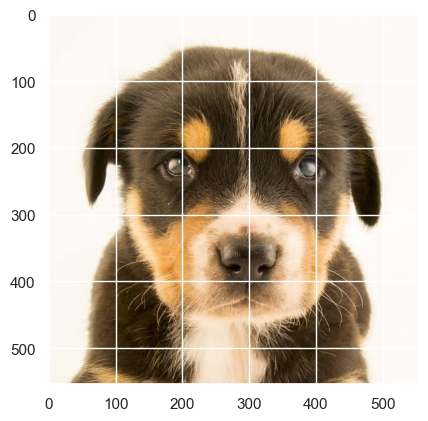

<Figure size 1000x1000 with 0 Axes>

dog
dog
dog
[ 0.4938457  98.17105     0.122679    0.78122723  0.4311893 ]
[1 3]
['dog', 'horse']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
This image most likely belongs to dog with a 65.58 percent confidence.


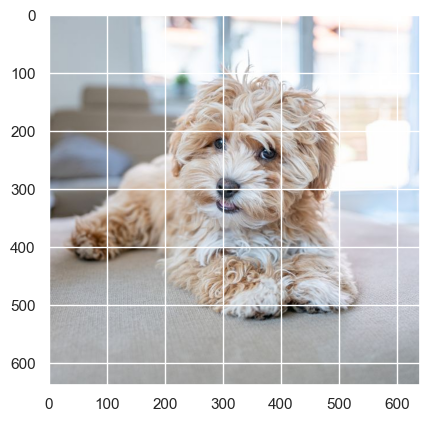

<Figure size 1000x1000 with 0 Axes>

dog
dog
dog
[18.963953 65.5765    2.904587  4.087536  8.467422]
[1 0]
['dog', 'cat']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
This image most likely belongs to dog with a 78.62 percent confidence.


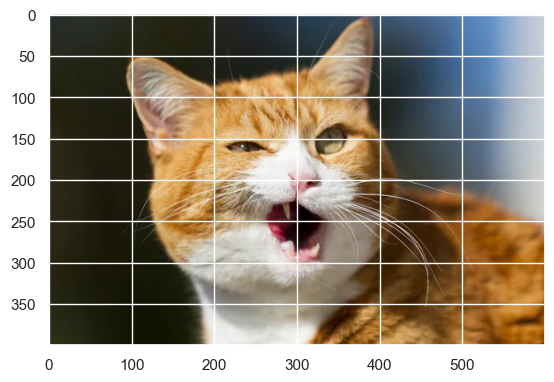

<Figure size 1000x1000 with 0 Axes>

dog
dog
dog
[ 1.9819045 78.61606    1.6357716  4.2131753 13.553093 ]
[1 4]
['dog', 'lion']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
This image most likely belongs to horse with a 75.56 percent confidence.


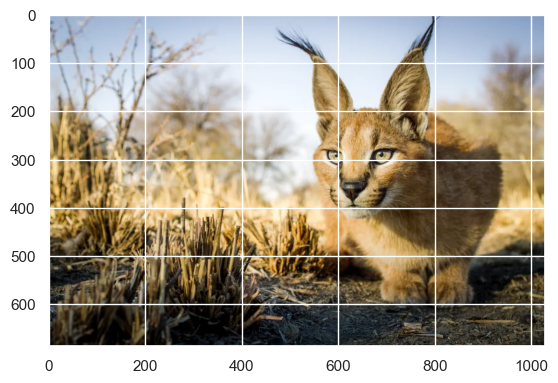

<Figure size 1000x1000 with 0 Axes>

dog
dog
horse
[ 0.5154137  2.7656677 14.456773  75.56273    6.699422 ]
[3 2]
['horse', 'elephant']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
This image most likely belongs to horse with a 69.48 percent confidence.


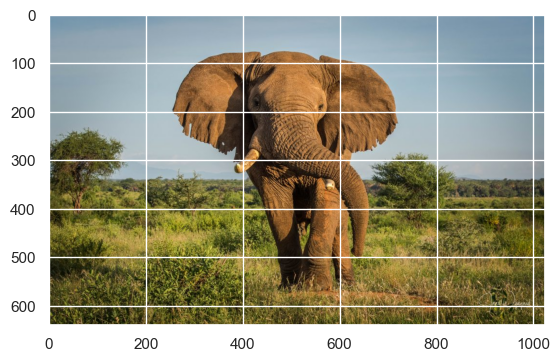

<Figure size 1000x1000 with 0 Axes>

dog
dog
horse
[1.4903960e-02 1.3681638e+00 1.0597105e+01 6.9483849e+01 1.8535986e+01]
[3 4]
['horse', 'lion']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
This image most likely belongs to elephant with a 61.35 percent confidence.


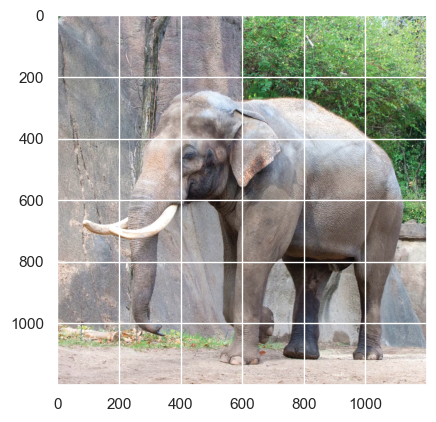

<Figure size 1000x1000 with 0 Axes>

dog
dog
elephant
[ 1.018696 26.724846 61.35124   8.721355  2.183873]
[2 1]
['elephant', 'dog']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
This image most likely belongs to dog with a 81.60 percent confidence.


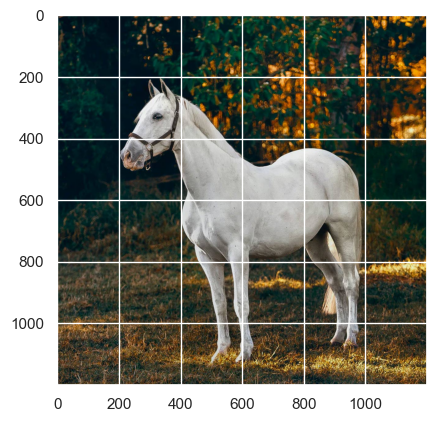

<Figure size 1000x1000 with 0 Axes>

dog
dog
dog
[ 0.93068796 81.60429     4.829768   12.454238    0.18102187]
[1 3]
['dog', 'horse']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
This image most likely belongs to horse with a 95.95 percent confidence.


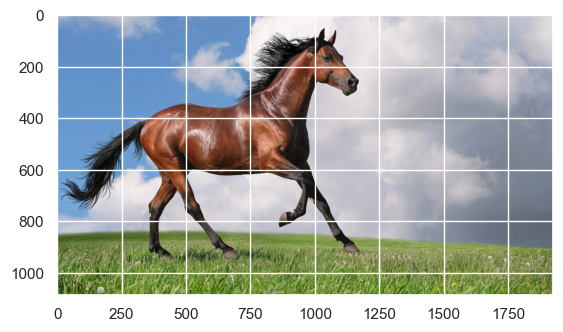

<Figure size 1000x1000 with 0 Axes>

dog
dog
horse
[5.5029344e-02 3.2368264e-01 2.7299266e+00 9.5948318e+01 9.4305050e-01]
[3 2]
['horse', 'elephant']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
This image most likely belongs to dog with a 39.61 percent confidence.


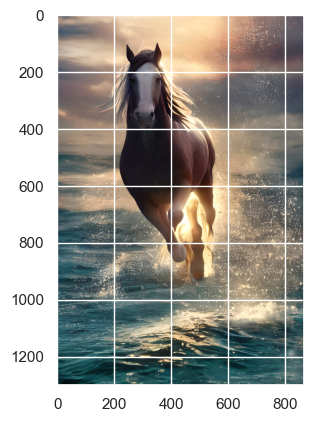

<Figure size 1000x1000 with 0 Axes>

dog
dog
dog
[34.743225  39.610264   2.9240806 15.449007   7.2734194]
[1 0]
['dog', 'cat']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
This image most likely belongs to dog with a 53.77 percent confidence.


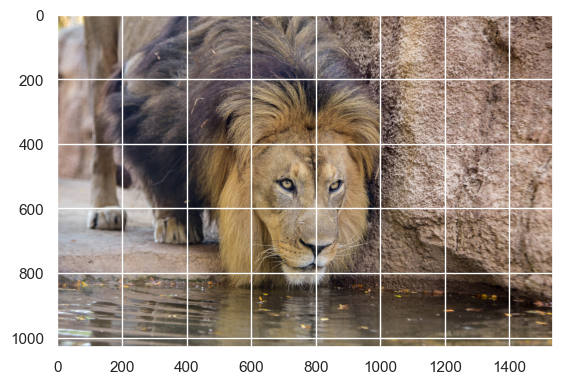

<Figure size 1000x1000 with 0 Axes>

dog
dog
dog
[ 2.970708  53.77375    3.6783073 16.420527  23.156708 ]
[1 4]
['dog', 'lion']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to lion with a 61.14 percent confidence.


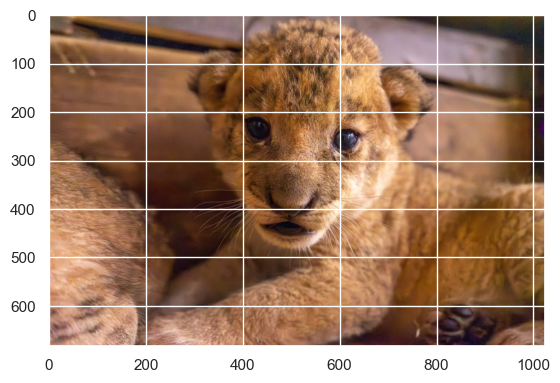

<Figure size 1000x1000 with 0 Axes>

dog
dog
lion
[ 4.736667   31.404093    0.75611335  1.9590245  61.144108  ]
[4 1]
['lion', 'dog']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
This image most likely belongs to lion with a 51.83 percent confidence.


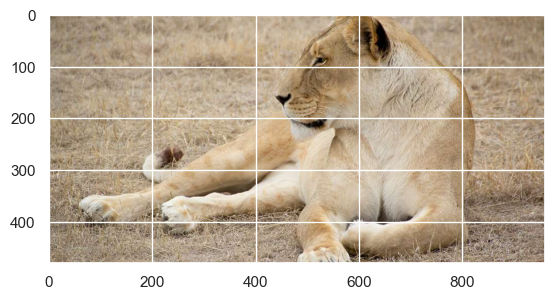

<Figure size 1000x1000 with 0 Axes>

dog
dog
lion
[ 4.2081137 12.260507  30.1268     1.574501  51.83007  ]
[4 2]
['lion', 'elephant']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
This image most likely belongs to dog with a 85.29 percent confidence.


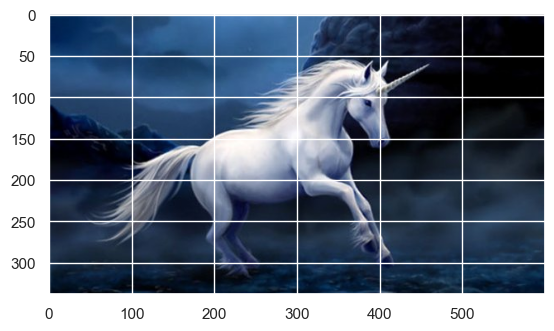

<Figure size 1000x1000 with 0 Axes>

dog
dog
dog
[12.481185   85.29185     0.3690533   1.7460378   0.11187077]
[1 0]
['dog', 'cat']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
This image most likely belongs to dog with a 70.42 percent confidence.


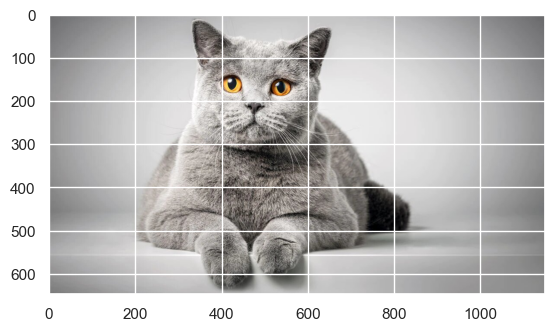

<Figure size 1000x1000 with 0 Axes>

dog
dog
dog
[14.72238   70.41514    1.0930276  1.3786582 12.390801 ]
[1 0]
['dog', 'cat']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
This image most likely belongs to dog with a 55.45 percent confidence.


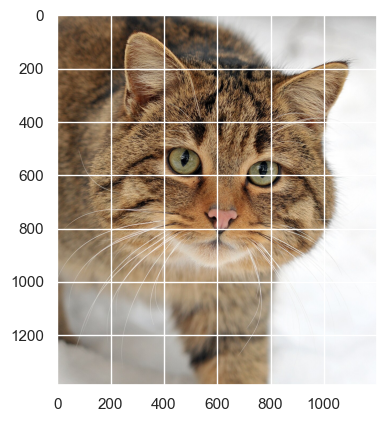

<Figure size 1000x1000 with 0 Axes>

dog
dog
dog
[17.24217    55.454124    0.07067694  0.74911344 26.483917  ]
[1 4]
['dog', 'lion']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to dog with a 78.03 percent confidence.


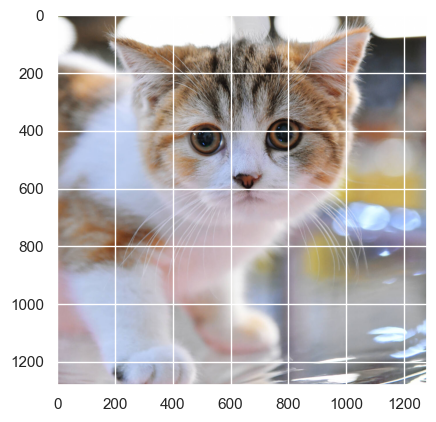

<Figure size 1000x1000 with 0 Axes>

dog
dog
dog
[20.344915   78.03355     0.08235711  1.1469346   0.3922441 ]
[1 0]
['dog', 'cat']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to cat with a 67.95 percent confidence.


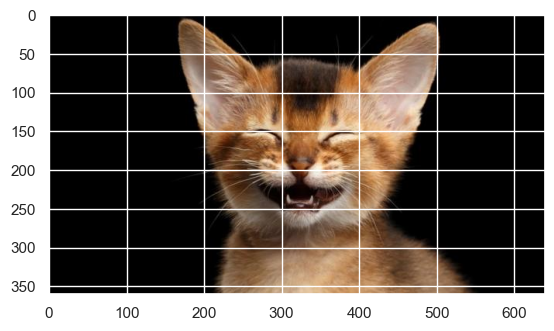

<Figure size 1000x1000 with 0 Axes>

dog
dog
cat
[67.94795    23.099281    0.61378306  2.3663867   5.9725895 ]
[0 1]
['cat', 'dog']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to cat with a 91.43 percent confidence.


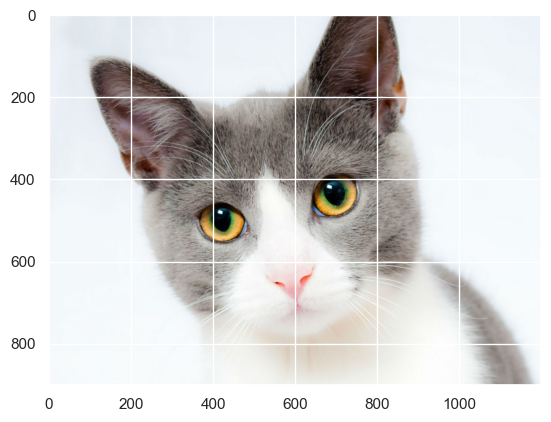

<Figure size 1000x1000 with 0 Axes>

dog
dog
cat
[9.1428040e+01 8.2991762e+00 1.6629945e-02 9.4001003e-02 1.6215861e-01]
[0 1]
['cat', 'dog']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to dog with a 94.29 percent confidence.


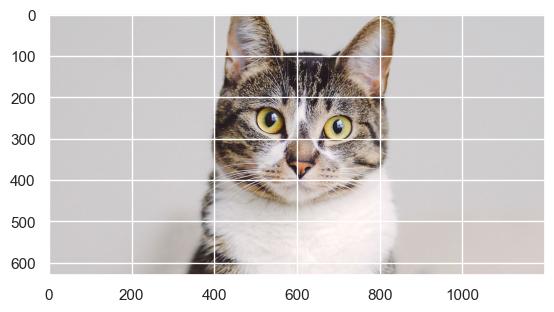

<Figure size 1000x1000 with 0 Axes>

dog
dog
dog
[3.9705698e+00 9.4286621e+01 6.7575122e-03 4.5764819e-01 1.2784021e+00]
[1 0]
['dog', 'cat']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to horse with a 56.97 percent confidence.


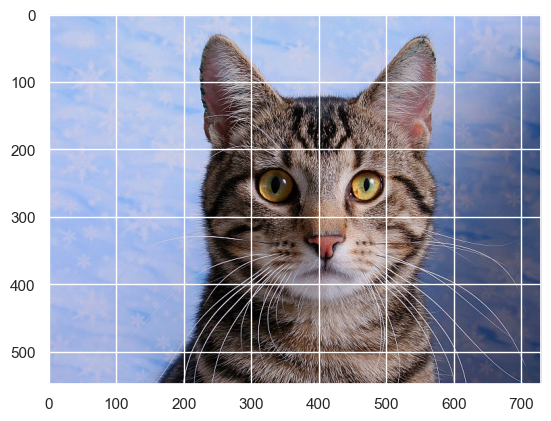

<Figure size 1000x1000 with 0 Axes>

dog
dog
horse
[ 3.5962906 11.193288   8.372909  56.97068   19.866833 ]
[3 4]
['horse', 'lion']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to horse with a 41.76 percent confidence.


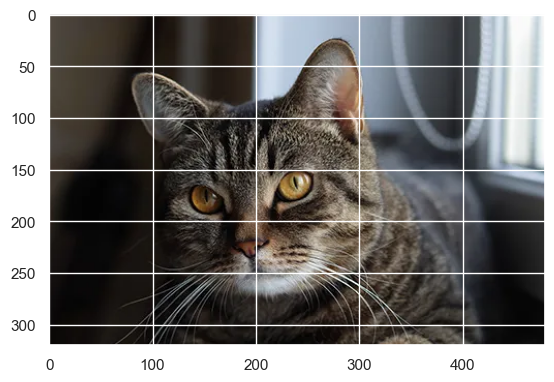

<Figure size 1000x1000 with 0 Axes>

dog
dog
horse
[24.019512  19.779133   5.1838827 41.75899    9.258478 ]
[3 0]
['horse', 'cat']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
This image most likely belongs to cat with a 97.90 percent confidence.


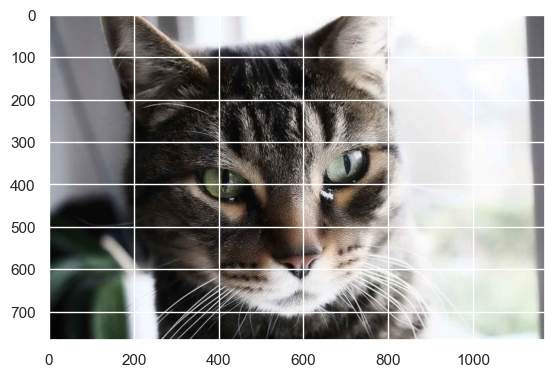

<Figure size 1000x1000 with 0 Axes>

dog
dog
cat
[9.7898773e+01 1.5773677e+00 2.1627087e-02 4.0891230e-01 9.3333595e-02]
[0 1]
['cat', 'dog']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
This image most likely belongs to dog with a 60.21 percent confidence.


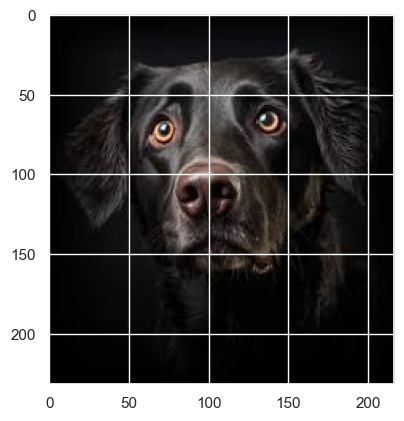

<Figure size 1000x1000 with 0 Axes>

dog
dog
dog
[14.762683  60.20758    3.0309489  9.570638  12.428149 ]
[1 0]
['dog', 'cat']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to cat with a 42.86 percent confidence.


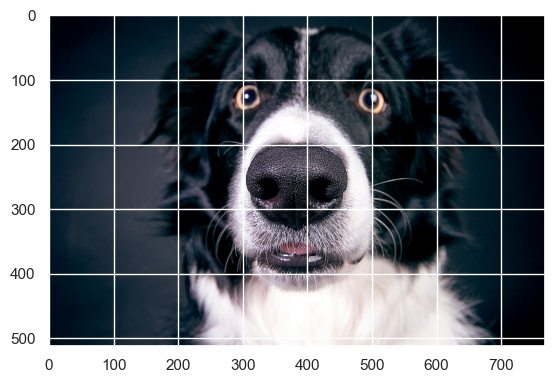

<Figure size 1000x1000 with 0 Axes>

dog
dog
cat
[42.863773  41.620644   3.026735  10.865754   1.6230971]
[0 1]
['cat', 'dog']


In [463]:
predic_2('test_animals/images1.jpg')
predic_2('test_animals/images2.jpg')
predic_2('test_animals/images3.jpg')
predic_2('test_animals/images4.jpg')
predic_2('test_animals/images5.jpg')
predic_2('test_animals/images6.jpg')
predic_2('test_animals/images7.jpg')
predic_2('test_animals/images8.jpg')
predic_2('test_animals/images9.jpg')
predic_2('test_animals/images10.jpg')
predic_2('test_animals/images11.jpg')
predic_2('test_animals/images12.jpg')
predic_2('test_animals/images13.jpg')
predic_2('test_animals/images15.jpg')
predic_2('test_animals/images16.jpg')
predic_2('test_animals/images17.jpg')
predic_2('test_animals/images18.jpg')
predic_2('test_animals/images19.jpg')
predic_2('test_animals/images20.jpg')
predic_2('test_animals/images21.jpg')
predic_2('test_animals/images22.jpg')
predic_2('test_animals/images23.jpg')
predic_2('test_animals/images24.jpg')
predic_2('test_animals/images25.jpg')

In [458]:
data_augmentation = keras.Sequential(
  [
    layers.RandomFlip("horizontal",
                      input_shape=(150,
                                  150,
                                  3)),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.1),
  ]
)

2024-06-02 22:43:01.222336: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


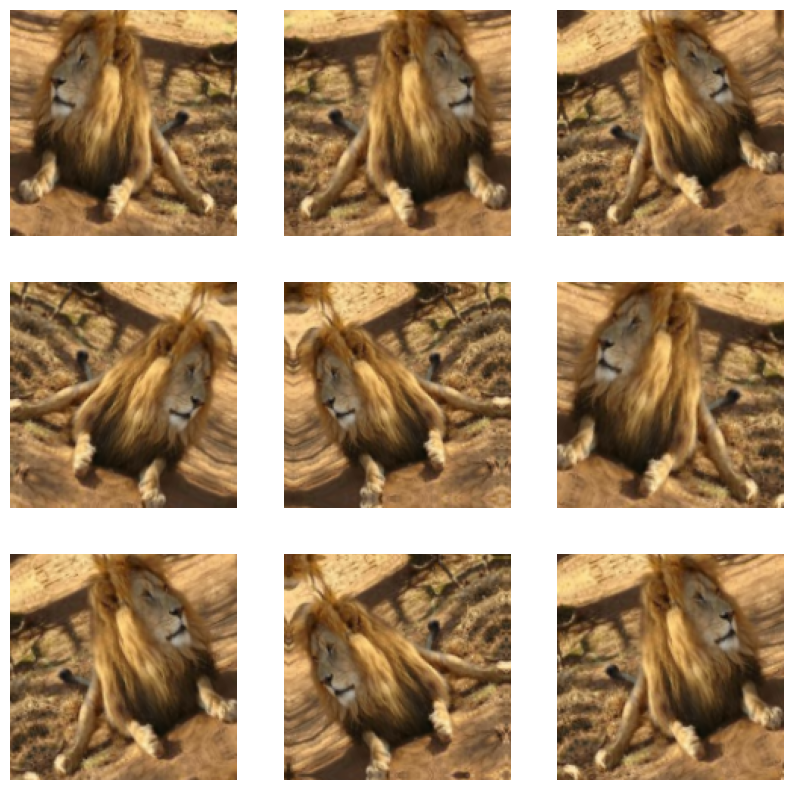

In [459]:
plt.figure(figsize=(10, 10))
for images, _ in train_data_gen.take(1):
  for i in range(9):
    augmented_images = data_augmentation(images)
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(augmented_images[0].numpy().astype("uint8"))
    plt.axis("off")

In [460]:
model = models.Sequential()
model.add(data_augmentation)
model.add(layers.Conv2D(16, (3, 3), activation='relu', input_shape=(IMG_HEIGHT, IMG_WIDTH, 3)))
model.add(layers.MaxPooling2D(2,2))
model.add(layers.Conv2D(32, (3,3), activation="relu"))
model.add(layers.MaxPooling2D(2,2))
model.add(layers.Conv2D(64, (3,3), activation="relu"))
model.add(layers.MaxPooling2D(2,2))



model.add(layers.Dropout(0.2))
model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dense(num_classes))

model.compile(optimizer= "adam",
              loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics= ["accuracy"])

model.summary()

Model: "sequential_42"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ sequential_41 (Sequential)      │ ?                      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_114 (Conv2D)             │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_114               │ ?                      │   0 (unbuilt) │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_115 (Conv2D)             │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_115               │ ?                      │   0 (unbuilt) │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_116 (Conv2D)             │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_116               │ ?                      │   0 (unbuilt) │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_10 (Dropout)            │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_31 (Flatten)            │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_63 (Dense)                │ ?                      │   0 (unbuilt) │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 0 (0.00 B)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 0 (0.00 B)

In [464]:
history = model.fit(x=train_data_gen, epochs=15,
                    validation_data=val_data_gen, validation_steps=total_val//batch_size)


Epoch 1/15
  9/306 ━━━━━━━━━━━━━━━━━━━━ 2:31 510ms/step - accuracy: 0.6244 - loss: 0.9746

Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 25/306 ━━━━━━━━━━━━━━━━━━━━ 2:10 465ms/step - accuracy: 0.6316 - loss: 0.9602

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 46/306 ━━━━━━━━━━━━━━━━━━━━ 2:03 477ms/step - accuracy: 0.6348 - loss: 0.9477

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 51/306 ━━━━━━━━━━━━━━━━━━━━ 2:00 471ms/step - accuracy: 0.6355 - loss: 0.9454

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 93/306 ━━━━━━━━━━━━━━━━━━━━ 1:35 451ms/step - accuracy: 0.6383 - loss: 0.9349

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


133/306 ━━━━━━━━━━━━━━━━━━━━ 1:16 442ms/step - accuracy: 0.6389 - loss: 0.9315

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


138/306 ━━━━━━━━━━━━━━━━━━━━ 1:13 440ms/step - accuracy: 0.6389 - loss: 0.9313

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


175/306 ━━━━━━━━━━━━━━━━━━━━ 56s 433ms/step - accuracy: 0.6392 - loss: 0.9294

202/306 ━━━━━━━━━━━━━━━━━━━━ 44s 428ms/step - accuracy: 0.6398 - loss: 0.9276

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


207/306 ━━━━━━━━━━━━━━━━━━━━ 42s 429ms/step - accuracy: 0.6400 - loss: 0.9272

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


211/306 ━━━━━━━━━━━━━━━━━━━━ 40s 429ms/step - accuracy: 0.6401 - loss: 0.9270

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


262/306 ━━━━━━━━━━━━━━━━━━━━ 18s 426ms/step - accuracy: 0.6414 - loss: 0.9244

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


280/306 ━━━━━━━━━━━━━━━━━━━━ 11s 427ms/step - accuracy: 0.6416 - loss: 0.9238

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 133s 433ms/step - accuracy: 0.6420 - loss: 0.9230 - val_accuracy: 0.5719 - val_loss: 1.1790
Epoch 2/15


Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 36/306 ━━━━━━━━━━━━━━━━━━━━ 1:30 336ms/step - accuracy: 0.6226 - loss: 0.9759

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 48/306 ━━━━━━━━━━━━━━━━━━━━ 1:26 336ms/step - accuracy: 0.6275 - loss: 0.9619

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 75/306 ━━━━━━━━━━━━━━━━━━━━ 1:18 338ms/step - accuracy: 0.6347 - loss: 0.9406

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 86/306 ━━━━━━━━━━━━━━━━━━━━ 1:14 338ms/step - accuracy: 0.6363 - loss: 0.9360

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


137/306 ━━━━━━━━━━━━━━━━━━━━ 57s 340ms/step - accuracy: 0.6416 - loss: 0.9211

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


148/306 ━━━━━━━━━━━━━━━━━━━━ 53s 339ms/step - accuracy: 0.6426 - loss: 0.9185

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


182/306 ━━━━━━━━━━━━━━━━━━━━ 42s 339ms/step - accuracy: 0.6454 - loss: 0.9114

194/306 ━━━━━━━━━━━━━━━━━━━━ 38s 341ms/step - accuracy: 0.6463 - loss: 0.9092

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


205/306 ━━━━━━━━━━━━━━━━━━━━ 34s 340ms/step - accuracy: 0.6470 - loss: 0.9073

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


210/306 ━━━━━━━━━━━━━━━━━━━━ 32s 341ms/step - accuracy: 0.6474 - loss: 0.9065

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


248/306 ━━━━━━━━━━━━━━━━━━━━ 19s 341ms/step - accuracy: 0.6497 - loss: 0.9010

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


262/306 ━━━━━━━━━━━━━━━━━━━━ 15s 341ms/step - accuracy: 0.6503 - loss: 0.8994

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 104s 340ms/step - accuracy: 0.6520 - loss: 0.8951 - val_accuracy: 0.6050 - val_loss: 1.0125
Epoch 3/15


2024-06-02 22:56:20.412281: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 29/306 ━━━━━━━━━━━━━━━━━━━━ 1:31 330ms/step - accuracy: 0.6600 - loss: 0.8966

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 43/306 ━━━━━━━━━━━━━━━━━━━━ 1:28 338ms/step - accuracy: 0.6604 - loss: 0.8881

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 54/306 ━━━━━━━━━━━━━━━━━━━━ 1:25 337ms/step - accuracy: 0.6618 - loss: 0.8822

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 91/306 ━━━━━━━━━━━━━━━━━━━━ 1:13 341ms/step - accuracy: 0.6663 - loss: 0.8674

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


122/306 ━━━━━━━━━━━━━━━━━━━━ 1:02 342ms/step - accuracy: 0.6692 - loss: 0.8606

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


152/306 ━━━━━━━━━━━━━━━━━━━━ 52s 342ms/step - accuracy: 0.6709 - loss: 0.8561

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


185/306 ━━━━━━━━━━━━━━━━━━━━ 41s 341ms/step - accuracy: 0.6724 - loss: 0.8519

190/306 ━━━━━━━━━━━━━━━━━━━━ 39s 342ms/step - accuracy: 0.6726 - loss: 0.8513

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


201/306 ━━━━━━━━━━━━━━━━━━━━ 35s 341ms/step - accuracy: 0.6730 - loss: 0.8502

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


203/306 ━━━━━━━━━━━━━━━━━━━━ 35s 341ms/step - accuracy: 0.6731 - loss: 0.8500

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


250/306 ━━━━━━━━━━━━━━━━━━━━ 19s 340ms/step - accuracy: 0.6747 - loss: 0.8459

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


279/306 ━━━━━━━━━━━━━━━━━━━━ 9s 341ms/step - accuracy: 0.6754 - loss: 0.8440

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 106s 347ms/step - accuracy: 0.6760 - loss: 0.8423 - val_accuracy: 0.5000 - val_loss: 1.4210
Epoch 4/15
 12/306 ━━━━━━━━━━━━━━━━━━━━ 1:36 330ms/step - accuracy: 0.5278 - loss: 1.2141

Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 30/306 ━━━━━━━━━━━━━━━━━━━━ 1:33 338ms/step - accuracy: 0.5238 - loss: 1.1913

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 42/306 ━━━━━━━━━━━━━━━━━━━━ 1:28 336ms/step - accuracy: 0.5311 - loss: 1.1683

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 45/306 ━━━━━━━━━━━━━━━━━━━━ 1:27 336ms/step - accuracy: 0.5334 - loss: 1.1627

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 90/306 ━━━━━━━━━━━━━━━━━━━━ 1:13 341ms/step - accuracy: 0.5638 - loss: 1.0954

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


140/306 ━━━━━━━━━━━━━━━━━━━━ 58s 352ms/step - accuracy: 0.5847 - loss: 1.0494

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


143/306 ━━━━━━━━━━━━━━━━━━━━ 57s 352ms/step - accuracy: 0.5857 - loss: 1.0472

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


178/306 ━━━━━━━━━━━━━━━━━━━━ 44s 348ms/step - accuracy: 0.5962 - loss: 1.0243

197/306 ━━━━━━━━━━━━━━━━━━━━ 37s 348ms/step - accuracy: 0.6009 - loss: 1.0139

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


201/306 ━━━━━━━━━━━━━━━━━━━━ 36s 348ms/step - accuracy: 0.6018 - loss: 1.0119

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


204/306 ━━━━━━━━━━━━━━━━━━━━ 35s 348ms/step - accuracy: 0.6025 - loss: 1.0104

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


252/306 ━━━━━━━━━━━━━━━━━━━━ 18s 347ms/step - accuracy: 0.6119 - loss: 0.9895

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


268/306 ━━━━━━━━━━━━━━━━━━━━ 13s 348ms/step - accuracy: 0.6145 - loss: 0.9837

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 106s 345ms/step - accuracy: 0.6201 - loss: 0.9712 - val_accuracy: 0.6050 - val_loss: 1.1130
Epoch 5/15


2024-06-02 22:59:52.475420: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 24/306 ━━━━━━━━━━━━━━━━━━━━ 1:34 335ms/step - accuracy: 0.5971 - loss: 1.0187

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 48/306 ━━━━━━━━━━━━━━━━━━━━ 1:26 334ms/step - accuracy: 0.6128 - loss: 0.9765

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 61/306 ━━━━━━━━━━━━━━━━━━━━ 1:22 336ms/step - accuracy: 0.6197 - loss: 0.9603

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 88/306 ━━━━━━━━━━━━━━━━━━━━ 1:13 335ms/step - accuracy: 0.6312 - loss: 0.9350

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


134/306 ━━━━━━━━━━━━━━━━━━━━ 57s 331ms/step - accuracy: 0.6446 - loss: 0.9056

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


142/306 ━━━━━━━━━━━━━━━━━━━━ 54s 331ms/step - accuracy: 0.6463 - loss: 0.9019

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


195/306 ━━━━━━━━━━━━━━━━━━━━ 36s 332ms/step - accuracy: 0.6551 - loss: 0.8824

196/306 ━━━━━━━━━━━━━━━━━━━━ 36s 331ms/step - accuracy: 0.6553 - loss: 0.8821

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


199/306 ━━━━━━━━━━━━━━━━━━━━ 35s 331ms/step - accuracy: 0.6557 - loss: 0.8811

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


201/306 ━━━━━━━━━━━━━━━━━━━━ 34s 331ms/step - accuracy: 0.6560 - loss: 0.8805

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


257/306 ━━━━━━━━━━━━━━━━━━━━ 16s 331ms/step - accuracy: 0.6625 - loss: 0.8661

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


262/306 ━━━━━━━━━━━━━━━━━━━━ 14s 331ms/step - accuracy: 0.6630 - loss: 0.8650

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 104s 338ms/step - accuracy: 0.6671 - loss: 0.8560 - val_accuracy: 0.7159 - val_loss: 0.7883
Epoch 6/15


Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 32/306 ━━━━━━━━━━━━━━━━━━━━ 1:30 329ms/step - accuracy: 0.7091 - loss: 0.7836

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 43/306 ━━━━━━━━━━━━━━━━━━━━ 1:25 327ms/step - accuracy: 0.7103 - loss: 0.7761

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 50/306 ━━━━━━━━━━━━━━━━━━━━ 1:25 334ms/step - accuracy: 0.7109 - loss: 0.7731

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 89/306 ━━━━━━━━━━━━━━━━━━━━ 1:12 333ms/step - accuracy: 0.7140 - loss: 0.7639

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


133/306 ━━━━━━━━━━━━━━━━━━━━ 57s 333ms/step - accuracy: 0.7154 - loss: 0.7594

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


139/306 ━━━━━━━━━━━━━━━━━━━━ 55s 333ms/step - accuracy: 0.7154 - loss: 0.7593

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


173/306 ━━━━━━━━━━━━━━━━━━━━ 43s 331ms/step - accuracy: 0.7153 - loss: 0.7586

202/306 ━━━━━━━━━━━━━━━━━━━━ 34s 330ms/step - accuracy: 0.7154 - loss: 0.7573

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


209/306 ━━━━━━━━━━━━━━━━━━━━ 31s 330ms/step - accuracy: 0.7154 - loss: 0.7570

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


211/306 ━━━━━━━━━━━━━━━━━━━━ 31s 330ms/step - accuracy: 0.7155 - loss: 0.7569

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


263/306 ━━━━━━━━━━━━━━━━━━━━ 14s 331ms/step - accuracy: 0.7158 - loss: 0.7547

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


264/306 ━━━━━━━━━━━━━━━━━━━━ 13s 331ms/step - accuracy: 0.7158 - loss: 0.7546

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 101s 329ms/step - accuracy: 0.7160 - loss: 0.7533 - val_accuracy: 0.6050 - val_loss: 1.1117
Epoch 7/15


2024-06-02 23:03:16.704363: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]


  4/306 ━━━━━━━━━━━━━━━━━━━━ 1:37 323ms/step - accuracy: 0.6073 - loss: 0.9867

Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 39/306 ━━━━━━━━━━━━━━━━━━━━ 1:29 337ms/step - accuracy: 0.6513 - loss: 0.9097

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 45/306 ━━━━━━━━━━━━━━━━━━━━ 1:27 335ms/step - accuracy: 0.6553 - loss: 0.9000

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 67/306 ━━━━━━━━━━━━━━━━━━━━ 1:19 331ms/step - accuracy: 0.6669 - loss: 0.8713

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 94/306 ━━━━━━━━━━━━━━━━━━━━ 1:09 330ms/step - accuracy: 0.6773 - loss: 0.8463

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


128/306 ━━━━━━━━━━━━━━━━━━━━ 58s 327ms/step - accuracy: 0.6853 - loss: 0.8266

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


137/306 ━━━━━━━━━━━━━━━━━━━━ 55s 327ms/step - accuracy: 0.6867 - loss: 0.8227

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


176/306 ━━━━━━━━━━━━━━━━━━━━ 42s 328ms/step - accuracy: 0.6922 - loss: 0.8086

200/306 ━━━━━━━━━━━━━━━━━━━━ 34s 327ms/step - accuracy: 0.6951 - loss: 0.8012

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


201/306 ━━━━━━━━━━━━━━━━━━━━ 34s 327ms/step - accuracy: 0.6952 - loss: 0.8009

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


204/306 ━━━━━━━━━━━━━━━━━━━━ 33s 327ms/step - accuracy: 0.6955 - loss: 0.8000

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


256/306 ━━━━━━━━━━━━━━━━━━━━ 16s 327ms/step - accuracy: 0.7002 - loss: 0.7878

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


267/306 ━━━━━━━━━━━━━━━━━━━━ 12s 327ms/step - accuracy: 0.7010 - loss: 0.7857

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 102s 333ms/step - accuracy: 0.7035 - loss: 0.7789 - val_accuracy: 0.7056 - val_loss: 0.7617
Epoch 8/15
  6/306 ━━━━━━━━━━━━━━━━━━━━ 1:41 339ms/step - accuracy: 0.7471 - loss: 0.7561

Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 27/306 ━━━━━━━━━━━━━━━━━━━━ 1:30 324ms/step - accuracy: 0.7204 - loss: 0.7794

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 49/306 ━━━━━━━━━━━━━━━━━━━━ 1:22 323ms/step - accuracy: 0.7227 - loss: 0.7661

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 53/306 ━━━━━━━━━━━━━━━━━━━━ 1:21 323ms/step - accuracy: 0.7231 - loss: 0.7641

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


100/306 ━━━━━━━━━━━━━━━━━━━━ 1:07 327ms/step - accuracy: 0.7264 - loss: 0.7470

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


129/306 ━━━━━━━━━━━━━━━━━━━━ 58s 329ms/step - accuracy: 0.7281 - loss: 0.7393

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


137/306 ━━━━━━━━━━━━━━━━━━━━ 55s 329ms/step - accuracy: 0.7282 - loss: 0.7378

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


175/306 ━━━━━━━━━━━━━━━━━━━━ 43s 330ms/step - accuracy: 0.7291 - loss: 0.7316

198/306 ━━━━━━━━━━━━━━━━━━━━ 35s 333ms/step - accuracy: 0.7298 - loss: 0.7283

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


202/306 ━━━━━━━━━━━━━━━━━━━━ 34s 333ms/step - accuracy: 0.7299 - loss: 0.7278

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


226/306 ━━━━━━━━━━━━━━━━━━━━ 26s 334ms/step - accuracy: 0.7306 - loss: 0.7247

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


262/306 ━━━━━━━━━━━━━━━━━━━━ 14s 336ms/step - accuracy: 0.7313 - loss: 0.7210

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


270/306 ━━━━━━━━━━━━━━━━━━━━ 12s 340ms/step - accuracy: 0.7315 - loss: 0.7203

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 104s 340ms/step - accuracy: 0.7321 - loss: 0.7175 - val_accuracy: 0.7647 - val_loss: 0.7578
Epoch 9/15


2024-06-02 23:06:42.872864: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 32/306 ━━━━━━━━━━━━━━━━━━━━ 1:40 366ms/step - accuracy: 0.6807 - loss: 0.8380

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 44/306 ━━━━━━━━━━━━━━━━━━━━ 1:34 360ms/step - accuracy: 0.6869 - loss: 0.8165

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 58/306 ━━━━━━━━━━━━━━━━━━━━ 1:29 360ms/step - accuracy: 0.6939 - loss: 0.7974

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 87/306 ━━━━━━━━━━━━━━━━━━━━ 1:17 353ms/step - accuracy: 0.7032 - loss: 0.7741

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


129/306 ━━━━━━━━━━━━━━━━━━━━ 1:02 350ms/step - accuracy: 0.7116 - loss: 0.7535

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


139/306 ━━━━━━━━━━━━━━━━━━━━ 58s 348ms/step - accuracy: 0.7131 - loss: 0.7496

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


172/306 ━━━━━━━━━━━━━━━━━━━━ 46s 346ms/step - accuracy: 0.7171 - loss: 0.7392

199/306 ━━━━━━━━━━━━━━━━━━━━ 36s 344ms/step - accuracy: 0.7197 - loss: 0.7327

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


205/306 ━━━━━━━━━━━━━━━━━━━━ 34s 344ms/step - accuracy: 0.7202 - loss: 0.7313

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


213/306 ━━━━━━━━━━━━━━━━━━━━ 32s 344ms/step - accuracy: 0.7209 - loss: 0.7296

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


251/306 ━━━━━━━━━━━━━━━━━━━━ 18s 342ms/step - accuracy: 0.7238 - loss: 0.7229

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


288/306 ━━━━━━━━━━━━━━━━━━━━ 6s 342ms/step - accuracy: 0.7260 - loss: 0.7177

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 106s 348ms/step - accuracy: 0.7269 - loss: 0.7155 - val_accuracy: 0.7481 - val_loss: 0.6943
Epoch 10/15
 31/306 ━━━━━━━━━━━━━━━━━━━━ 1:32 337ms/step - accuracy: 0.7588 - loss: 0.6695

Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 41/306 ━━━━━━━━━━━━━━━━━━━━ 1:28 336ms/step - accuracy: 0.7565 - loss: 0.6705

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9
Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 45/306 ━━━━━━━━━━━━━━━━━━━━ 1:27 336ms/step - accuracy: 0.7559 - loss: 0.6700

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 91/306 ━━━━━━━━━━━━━━━━━━━━ 1:13 340ms/step - accuracy: 0.7538 - loss: 0.6676

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


141/306 ━━━━━━━━━━━━━━━━━━━━ 55s 338ms/step - accuracy: 0.7524 - loss: 0.6672

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


149/306 ━━━━━━━━━━━━━━━━━━━━ 53s 338ms/step - accuracy: 0.7523 - loss: 0.6672

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


179/306 ━━━━━━━━━━━━━━━━━━━━ 42s 336ms/step - accuracy: 0.7519 - loss: 0.6668

190/306 ━━━━━━━━━━━━━━━━━━━━ 38s 336ms/step - accuracy: 0.7518 - loss: 0.6667

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


199/306 ━━━━━━━━━━━━━━━━━━━━ 36s 337ms/step - accuracy: 0.7518 - loss: 0.6665

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


226/306 ━━━━━━━━━━━━━━━━━━━━ 26s 336ms/step - accuracy: 0.7516 - loss: 0.6661

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


244/306 ━━━━━━━━━━━━━━━━━━━━ 20s 336ms/step - accuracy: 0.7516 - loss: 0.6658

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


265/306 ━━━━━━━━━━━━━━━━━━━━ 13s 335ms/step - accuracy: 0.7516 - loss: 0.6654

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 102s 335ms/step - accuracy: 0.7516 - loss: 0.6648 - val_accuracy: 0.5126 - val_loss: 1.5476
Epoch 11/15


2024-06-02 23:10:11.843119: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 27/306 ━━━━━━━━━━━━━━━━━━━━ 1:34 337ms/step - accuracy: 0.4662 - loss: 1.4160

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 54/306 ━━━━━━━━━━━━━━━━━━━━ 1:24 336ms/step - accuracy: 0.5165 - loss: 1.2701

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 70/306 ━━━━━━━━━━━━━━━━━━━━ 1:20 340ms/step - accuracy: 0.5384 - loss: 1.2122

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


102/306 ━━━━━━━━━━━━━━━━━━━━ 1:08 337ms/step - accuracy: 0.5702 - loss: 1.1276

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


124/306 ━━━━━━━━━━━━━━━━━━━━ 1:02 341ms/step - accuracy: 0.5866 - loss: 1.0850

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


139/306 ━━━━━━━━━━━━━━━━━━━━ 56s 340ms/step - accuracy: 0.5958 - loss: 1.0609

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


173/306 ━━━━━━━━━━━━━━━━━━━━ 45s 339ms/step - accuracy: 0.6131 - loss: 1.0159

194/306 ━━━━━━━━━━━━━━━━━━━━ 37s 338ms/step - accuracy: 0.6217 - loss: 0.9932

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


211/306 ━━━━━━━━━━━━━━━━━━━━ 32s 338ms/step - accuracy: 0.6278 - loss: 0.9771

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


221/306 ━━━━━━━━━━━━━━━━━━━━ 28s 340ms/step - accuracy: 0.6311 - loss: 0.9685

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


256/306 ━━━━━━━━━━━━━━━━━━━━ 16s 340ms/step - accuracy: 0.6413 - loss: 0.9422

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


278/306 ━━━━━━━━━━━━━━━━━━━━ 9s 341ms/step - accuracy: 0.6467 - loss: 0.9282

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 106s 348ms/step - accuracy: 0.6530 - loss: 0.9121 - val_accuracy: 0.6103 - val_loss: 1.0117
Epoch 12/15
  4/306 ━━━━━━━━━━━━━━━━━━━━ 1:56 387ms/step - accuracy: 0.5841 - loss: 1.1133

Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 36/306 ━━━━━━━━━━━━━━━━━━━━ 1:32 342ms/step - accuracy: 0.6340 - loss: 0.9442

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 45/306 ━━━━━━━━━━━━━━━━━━━━ 1:28 339ms/step - accuracy: 0.6432 - loss: 0.9198

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 47/306 ━━━━━━━━━━━━━━━━━━━━ 1:27 339ms/step - accuracy: 0.6450 - loss: 0.9150

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 94/306 ━━━━━━━━━━━━━━━━━━━━ 1:12 342ms/step - accuracy: 0.6743 - loss: 0.8420

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


131/306 ━━━━━━━━━━━━━━━━━━━━ 1:00 343ms/step - accuracy: 0.6876 - loss: 0.8082

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


147/306 ━━━━━━━━━━━━━━━━━━━━ 54s 345ms/step - accuracy: 0.6919 - loss: 0.7971

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


177/306 ━━━━━━━━━━━━━━━━━━━━ 44s 346ms/step - accuracy: 0.6988 - loss: 0.7795

192/306 ━━━━━━━━━━━━━━━━━━━━ 39s 347ms/step - accuracy: 0.7018 - loss: 0.7721

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


203/306 ━━━━━━━━━━━━━━━━━━━━ 35s 347ms/step - accuracy: 0.7038 - loss: 0.7671

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


205/306 ━━━━━━━━━━━━━━━━━━━━ 35s 347ms/step - accuracy: 0.7041 - loss: 0.7662

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


256/306 ━━━━━━━━━━━━━━━━━━━━ 17s 346ms/step - accuracy: 0.7116 - loss: 0.7476

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


268/306 ━━━━━━━━━━━━━━━━━━━━ 13s 346ms/step - accuracy: 0.7131 - loss: 0.7439

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 106s 345ms/step - accuracy: 0.7173 - loss: 0.7336 - val_accuracy: 0.6975 - val_loss: 0.7457
Epoch 13/15


2024-06-02 23:13:43.929291: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 29/306 ━━━━━━━━━━━━━━━━━━━━ 1:37 354ms/step - accuracy: 0.7520 - loss: 0.6642

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 46/306 ━━━━━━━━━━━━━━━━━━━━ 1:31 352ms/step - accuracy: 0.7534 - loss: 0.6548

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9
Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 88/306 ━━━━━━━━━━━━━━━━━━━━ 1:14 343ms/step - accuracy: 0.7581 - loss: 0.6373

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


124/306 ━━━━━━━━━━━━━━━━━━━━ 1:02 343ms/step - accuracy: 0.7615 - loss: 0.6263

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


138/306 ━━━━━━━━━━━━━━━━━━━━ 57s 344ms/step - accuracy: 0.7624 - loss: 0.6235

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


180/306 ━━━━━━━━━━━━━━━━━━━━ 43s 343ms/step - accuracy: 0.7646 - loss: 0.6175

205/306 ━━━━━━━━━━━━━━━━━━━━ 34s 344ms/step - accuracy: 0.7656 - loss: 0.6149

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


210/306 ━━━━━━━━━━━━━━━━━━━━ 33s 344ms/step - accuracy: 0.7658 - loss: 0.6145

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


223/306 ━━━━━━━━━━━━━━━━━━━━ 28s 345ms/step - accuracy: 0.7662 - loss: 0.6135

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


246/306 ━━━━━━━━━━━━━━━━━━━━ 20s 345ms/step - accuracy: 0.7669 - loss: 0.6120

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


276/306 ━━━━━━━━━━━━━━━━━━━━ 10s 344ms/step - accuracy: 0.7675 - loss: 0.6107

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 108s 351ms/step - accuracy: 0.7680 - loss: 0.6096 - val_accuracy: 0.7453 - val_loss: 0.6642
Epoch 14/15
 15/306 ━━━━━━━━━━━━━━━━━━━━ 1:42 353ms/step - accuracy: 0.7468 - loss: 0.6707

Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 26/306 ━━━━━━━━━━━━━━━━━━━━ 1:36 345ms/step - accuracy: 0.7572 - loss: 0.6460

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 41/306 ━━━━━━━━━━━━━━━━━━━━ 1:31 346ms/step - accuracy: 0.7644 - loss: 0.6305

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 80/306 ━━━━━━━━━━━━━━━━━━━━ 1:18 346ms/step - accuracy: 0.7723 - loss: 0.6091

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 92/306 ━━━━━━━━━━━━━━━━━━━━ 1:14 346ms/step - accuracy: 0.7734 - loss: 0.6054

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


129/306 ━━━━━━━━━━━━━━━━━━━━ 1:01 346ms/step - accuracy: 0.7756 - loss: 0.5979

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


149/306 ━━━━━━━━━━━━━━━━━━━━ 54s 346ms/step - accuracy: 0.7764 - loss: 0.5953

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


184/306 ━━━━━━━━━━━━━━━━━━━━ 42s 344ms/step - accuracy: 0.7773 - loss: 0.5920

196/306 ━━━━━━━━━━━━━━━━━━━━ 37s 344ms/step - accuracy: 0.7776 - loss: 0.5911

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


208/306 ━━━━━━━━━━━━━━━━━━━━ 33s 345ms/step - accuracy: 0.7778 - loss: 0.5903

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


212/306 ━━━━━━━━━━━━━━━━━━━━ 32s 344ms/step - accuracy: 0.7779 - loss: 0.5900

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


245/306 ━━━━━━━━━━━━━━━━━━━━ 21s 346ms/step - accuracy: 0.7783 - loss: 0.5887

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


273/306 ━━━━━━━━━━━━━━━━━━━━ 11s 351ms/step - accuracy: 0.7785 - loss: 0.5878

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 108s 351ms/step - accuracy: 0.7788 - loss: 0.5871 - val_accuracy: 0.6134 - val_loss: 1.0835
Epoch 15/15


2024-06-02 23:17:19.101054: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]


  5/306 ━━━━━━━━━━━━━━━━━━━━ 1:46 353ms/step - accuracy: 0.7657 - loss: 0.5516

Corrupt JPEG data: 162 extraneous bytes before marker 0xd9


 27/306 ━━━━━━━━━━━━━━━━━━━━ 1:40 359ms/step - accuracy: 0.7556 - loss: 0.6030

Corrupt JPEG data: 65 extraneous bytes before marker 0xd9


 47/306 ━━━━━━━━━━━━━━━━━━━━ 1:32 356ms/step - accuracy: 0.7639 - loss: 0.5981

Corrupt JPEG data: 239 extraneous bytes before marker 0xd9


 49/306 ━━━━━━━━━━━━━━━━━━━━ 1:31 355ms/step - accuracy: 0.7646 - loss: 0.5973

Corrupt JPEG data: 214 extraneous bytes before marker 0xd9


 85/306 ━━━━━━━━━━━━━━━━━━━━ 1:17 352ms/step - accuracy: 0.7722 - loss: 0.5868

Corrupt JPEG data: 396 extraneous bytes before marker 0xd9


126/306 ━━━━━━━━━━━━━━━━━━━━ 1:02 350ms/step - accuracy: 0.7757 - loss: 0.5813

Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


156/306 ━━━━━━━━━━━━━━━━━━━━ 52s 350ms/step - accuracy: 0.7772 - loss: 0.5792

Corrupt JPEG data: 252 extraneous bytes before marker 0xd9


173/306 ━━━━━━━━━━━━━━━━━━━━ 46s 350ms/step - accuracy: 0.7779 - loss: 0.5782

205/306 ━━━━━━━━━━━━━━━━━━━━ 35s 350ms/step - accuracy: 0.7790 - loss: 0.5763

Corrupt JPEG data: 228 extraneous bytes before marker 0xd9


211/306 ━━━━━━━━━━━━━━━━━━━━ 33s 349ms/step - accuracy: 0.7792 - loss: 0.5760

Corrupt JPEG data: 1153 extraneous bytes before marker 0xd9


219/306 ━━━━━━━━━━━━━━━━━━━━ 30s 349ms/step - accuracy: 0.7794 - loss: 0.5757

Corrupt JPEG data: 128 extraneous bytes before marker 0xd9


254/306 ━━━━━━━━━━━━━━━━━━━━ 18s 350ms/step - accuracy: 0.7800 - loss: 0.5745

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


267/306 ━━━━━━━━━━━━━━━━━━━━ 13s 350ms/step - accuracy: 0.7803 - loss: 0.5741

Corrupt JPEG data: 2226 extraneous bytes before marker 0xd9


306/306 ━━━━━━━━━━━━━━━━━━━━ 109s 357ms/step - accuracy: 0.7808 - loss: 0.5731 - val_accuracy: 0.7216 - val_loss: 0.7262


In [465]:
model.save('model4.keras')

In [466]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

print(acc)
print(val_acc)
print(loss)
print(val_loss)

[0.645407497882843, 0.662312388420105, 0.6816761493682861, 0.6607756018638611, 0.6925106048583984, 0.7174837589263916, 0.721018373966217, 0.7376671433448792, 0.7417140603065491, 0.752164363861084, 0.7157676219940186, 0.7475026845932007, 0.7723221182823181, 0.7804415822029114, 0.7848727107048035]
[0.5718749761581421, 0.605042040348053, 0.5, 0.605042040348053, 0.7159374952316284, 0.605042040348053, 0.7056249976158142, 0.7647058963775635, 0.7481250166893005, 0.5126050710678101, 0.6103125214576721, 0.6974790096282959, 0.745312511920929, 0.6134454011917114, 0.7215625047683716]
[0.9156672358512878, 0.8697088360786438, 0.8258559703826904, 0.8812054395675659, 0.8002822399139404, 0.743859052658081, 0.7307220697402954, 0.6947271227836609, 0.6802026033401489, 0.6593972444534302, 0.7515678405761719, 0.6587685346603394, 0.5999175906181335, 0.5819110870361328, 0.565050482749939]
[1.1790087223052979, 1.0125089883804321, 1.420998215675354, 1.1129677295684814, 0.7882624268531799, 1.1117051839828491, 0.

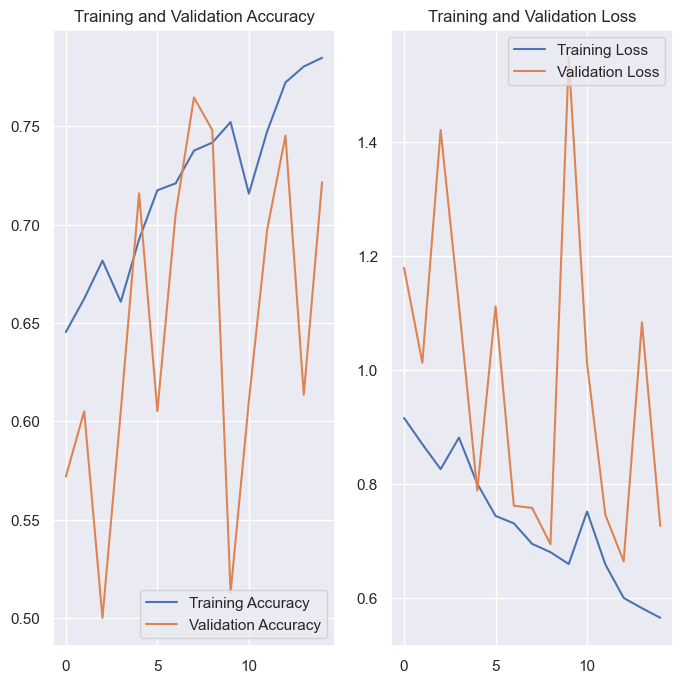

In [467]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [468]:
predict = []
def predic_2(A):
    img = tf.keras.utils.load_img(A, target_size = (150, 150))
    img_array = tf.keras.utils.img_to_array(img)
    img_array = tf.expand_dims(img_array, 0)

    predictions = model.predict(img_array)
    score = tf.nn.softmax(predictions[0])
    predict.append(class_names[np.argmax(score)])

    print(
        "This image most likely belongs to {} with a {:.2f} percent confidence."
        .format(class_names[np.argmax(score)], 100 * np.max(score))
    )
    
    imagen = plt.imread(A)
    plt.imshow(imagen)
    plt.figure(figsize=(10,10))
    plt.show()
    print(class_names[np.all(score)])
    print(class_names[np.any(score)])
    print(class_names[np.argmax(score)])
    print(np.array(score)*100)
    sorted = np.argsort(score)[::-1]
    print(sorted[:2])
    print([class_names[i] for i in sorted[:2]])


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to dog with a 54.08 percent confidence.


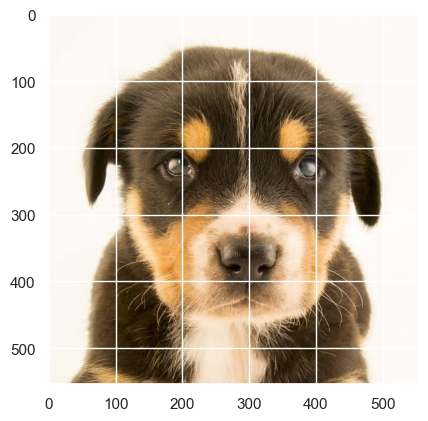

<Figure size 1000x1000 with 0 Axes>

dog
dog
dog
[ 1.0610592 54.08112    4.042102   1.4222224 39.39349  ]
[1 4]
['dog', 'lion']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
This image most likely belongs to cat with a 42.83 percent confidence.


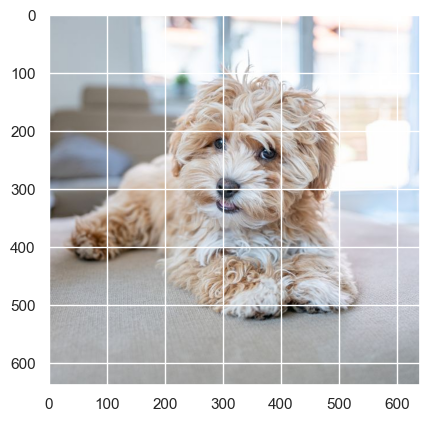

<Figure size 1000x1000 with 0 Axes>

dog
dog
cat
[42.832165  33.339626   3.0589545 14.767774   6.0014834]
[0 1]
['cat', 'dog']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to cat with a 99.62 percent confidence.


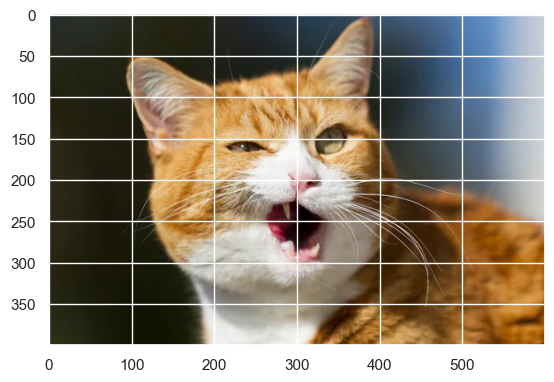

<Figure size 1000x1000 with 0 Axes>

dog
dog
cat
[9.9615219e+01 3.7160563e-01 7.3793608e-06 5.1610259e-06 1.3157275e-02]
[0 1]
['cat', 'dog']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
This image most likely belongs to lion with a 62.15 percent confidence.


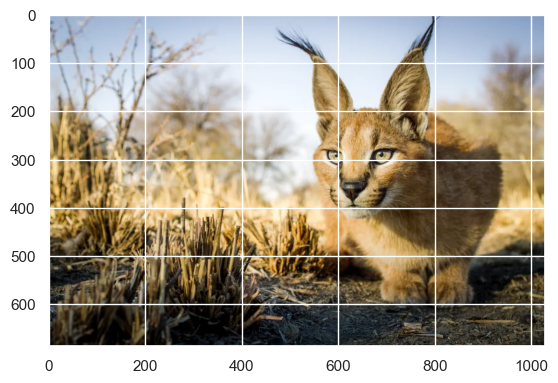

<Figure size 1000x1000 with 0 Axes>

dog
dog
lion
[ 5.186729   0.8180893 29.429468   2.4114459 62.15427  ]
[4 2]
['lion', 'elephant']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to horse with a 91.09 percent confidence.


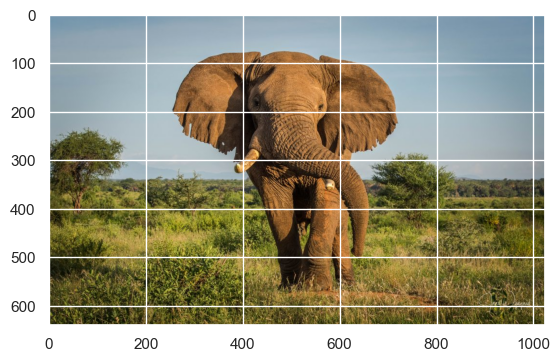

<Figure size 1000x1000 with 0 Axes>

dog
dog
horse
[1.3500759e-02 2.2207817e-01 6.1499267e+00 9.1091827e+01 2.5226734e+00]
[3 2]
['horse', 'elephant']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to elephant with a 94.39 percent confidence.


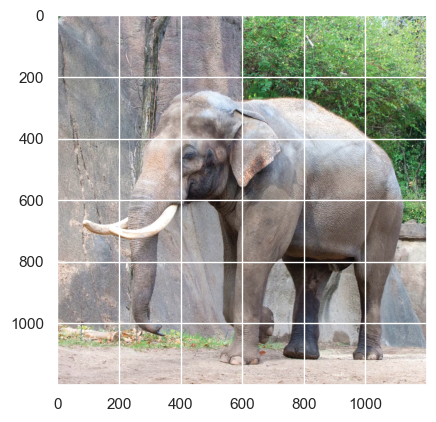

<Figure size 1000x1000 with 0 Axes>

dog
dog
elephant
[ 0.60014284  0.6421493  94.39052     3.1699014   1.1972932 ]
[2 3]
['elephant', 'horse']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to horse with a 48.27 percent confidence.


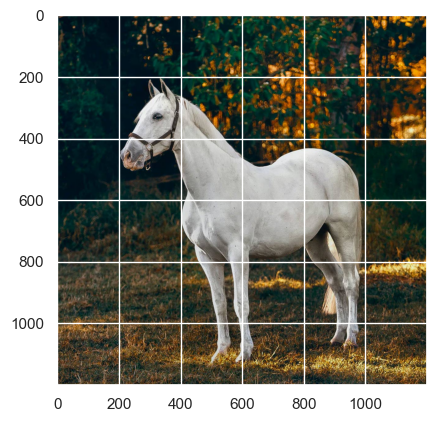

<Figure size 1000x1000 with 0 Axes>

dog
dog
horse
[ 9.595525 11.896551 15.378783 48.27118  14.857958]
[3 2]
['horse', 'elephant']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to horse with a 99.89 percent confidence.


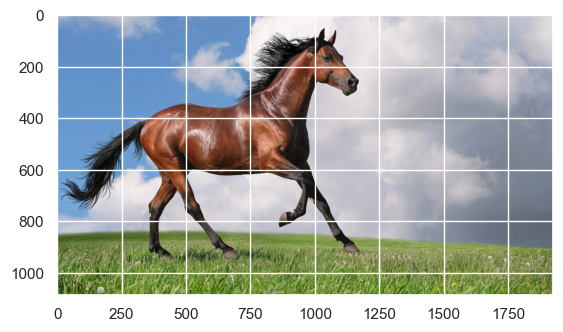

<Figure size 1000x1000 with 0 Axes>

dog
dog
horse
[6.3807651e-04 6.0945493e-03 8.2424380e-02 9.9889671e+01 2.1168027e-02]
[3 2]
['horse', 'elephant']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to cat with a 76.93 percent confidence.


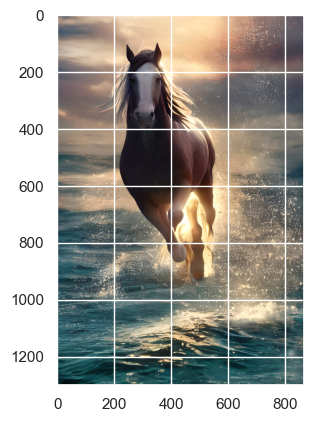

<Figure size 1000x1000 with 0 Axes>

dog
dog
cat
[76.93107    9.380503   4.901615   5.3327484  3.4540634]
[0 1]
['cat', 'dog']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to lion with a 65.64 percent confidence.


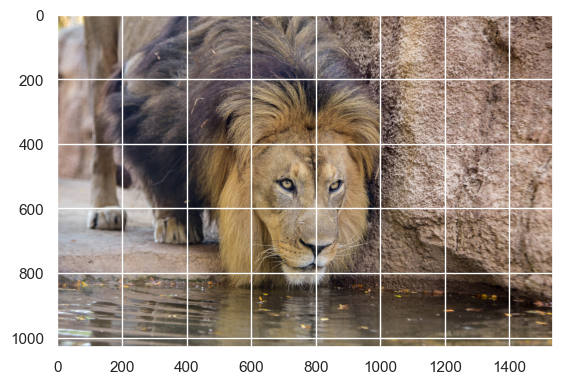

<Figure size 1000x1000 with 0 Axes>

dog
dog
lion
[ 7.9567766  1.7934921 22.473738   2.1405425 65.63546  ]
[4 2]
['lion', 'elephant']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
This image most likely belongs to lion with a 95.88 percent confidence.


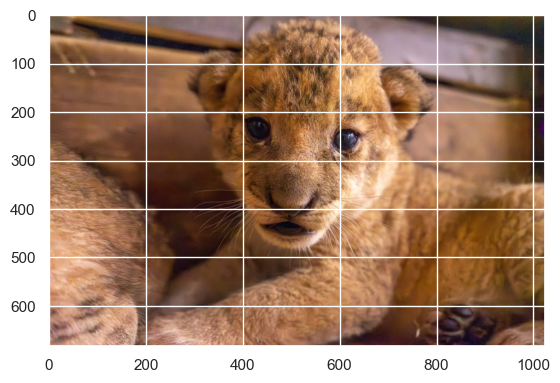

<Figure size 1000x1000 with 0 Axes>

dog
dog
lion
[ 1.6923176   2.140643    0.10463833  0.18305838 95.87934   ]
[4 1]
['lion', 'dog']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to lion with a 98.56 percent confidence.


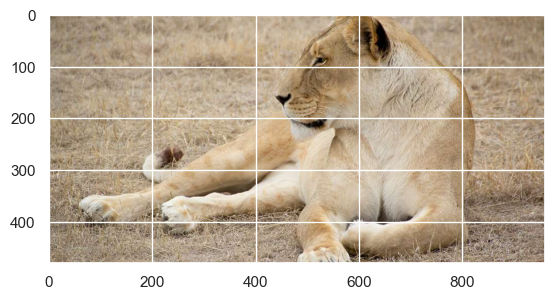

<Figure size 1000x1000 with 0 Axes>

dog
dog
lion
[3.8750279e-01 2.1217522e-01 7.6459676e-01 7.0975341e-02 9.8564743e+01]
[4 2]
['lion', 'elephant']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
This image most likely belongs to horse with a 60.24 percent confidence.


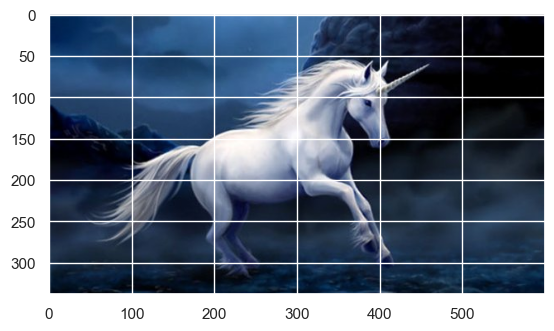

<Figure size 1000x1000 with 0 Axes>

dog
dog
horse
[ 2.1765628 28.103521   7.471586  60.242123   2.00621  ]
[3 1]
['horse', 'dog']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to cat with a 56.32 percent confidence.


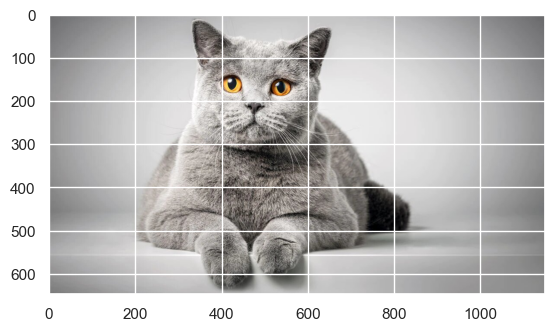

<Figure size 1000x1000 with 0 Axes>

dog
dog
cat
[56.317955  21.793377   3.6235373  3.4311624 14.833963 ]
[0 1]
['cat', 'dog']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
This image most likely belongs to cat with a 99.72 percent confidence.


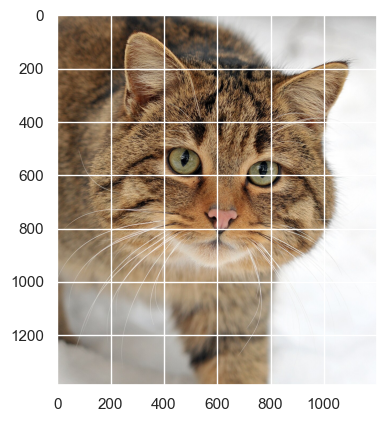

<Figure size 1000x1000 with 0 Axes>

dog
dog
cat
[9.9722641e+01 8.7162144e-03 7.0604505e-03 2.3576785e-03 2.5922844e-01]
[0 4]
['cat', 'lion']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to cat with a 99.17 percent confidence.


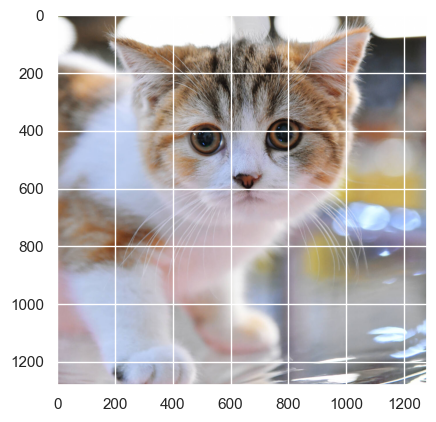

<Figure size 1000x1000 with 0 Axes>

dog
dog
cat
[9.9173645e+01 7.5590074e-01 1.7488867e-03 2.6775710e-02 4.1925315e-02]
[0 1]
['cat', 'dog']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to lion with a 73.88 percent confidence.


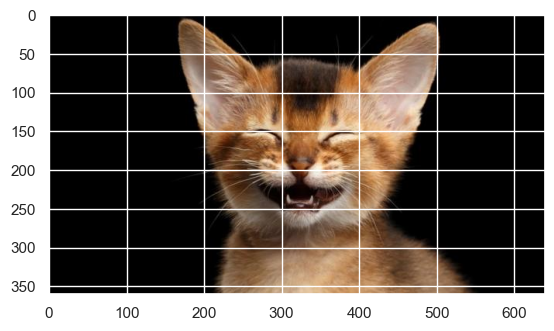

<Figure size 1000x1000 with 0 Axes>

dog
dog
lion
[ 2.4425366  0.7232795 20.98002    1.9767666 73.8774   ]
[4 2]
['lion', 'elephant']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to cat with a 100.00 percent confidence.


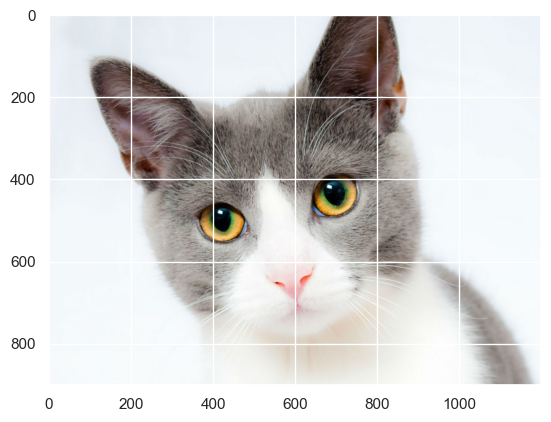

<Figure size 1000x1000 with 0 Axes>

dog
dog
cat
[9.9999985e+01 6.2534505e-06 4.9430827e-07 7.2056952e-07 2.2804751e-07]
[0 1]
['cat', 'dog']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
This image most likely belongs to cat with a 100.00 percent confidence.


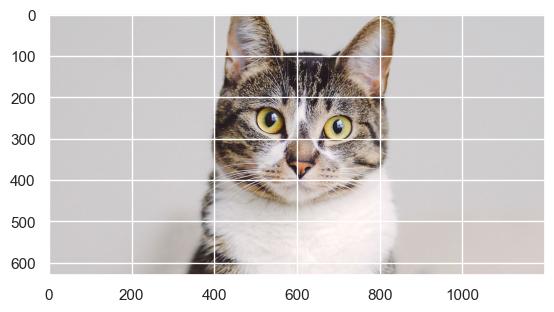

<Figure size 1000x1000 with 0 Axes>

dog
dog
cat
[9.9999809e+01 3.2513359e-05 8.7794448e-05 6.0533785e-05 1.3199852e-05]
[0 2]
['cat', 'elephant']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
This image most likely belongs to cat with a 98.74 percent confidence.


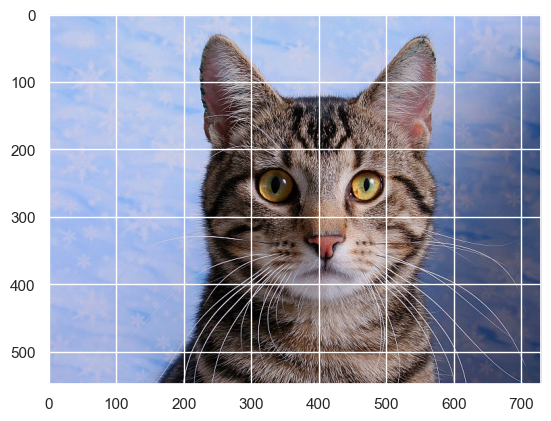

<Figure size 1000x1000 with 0 Axes>

dog
dog
cat
[9.8738739e+01 5.5584833e-03 8.2051978e-02 1.1315978e+00 4.2054821e-02]
[0 3]
['cat', 'horse']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
This image most likely belongs to cat with a 86.75 percent confidence.


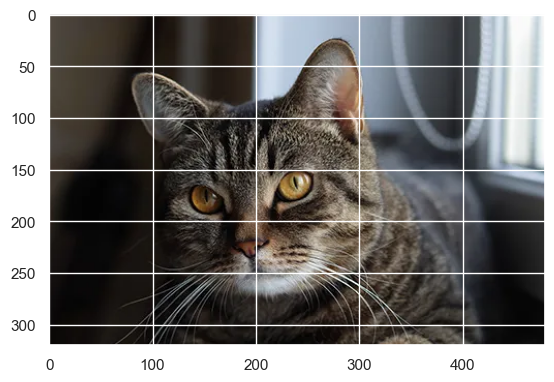

<Figure size 1000x1000 with 0 Axes>

dog
dog
cat
[86.74977     0.15633613  6.673348    1.0690929   5.3514442 ]
[0 2]
['cat', 'elephant']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to cat with a 99.96 percent confidence.


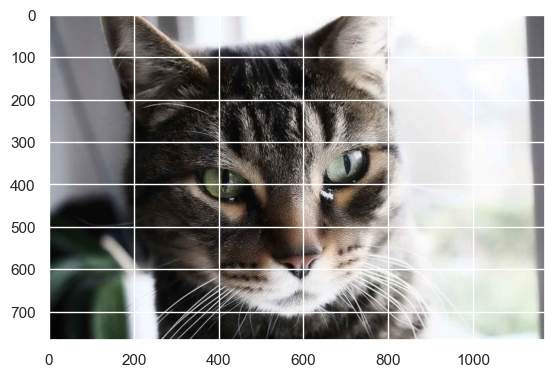

<Figure size 1000x1000 with 0 Axes>

dog
dog
cat
[9.9959068e+01 1.0059932e-02 1.1707436e-02 1.1930469e-02 7.2371475e-03]
[0 3]
['cat', 'horse']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to horse with a 54.82 percent confidence.


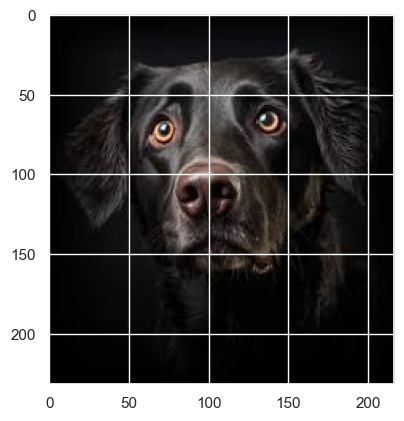

<Figure size 1000x1000 with 0 Axes>

dog
dog
horse
[ 5.6384463 10.103052   7.7470737 54.815357  21.696068 ]
[3 4]
['horse', 'lion']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to horse with a 68.96 percent confidence.


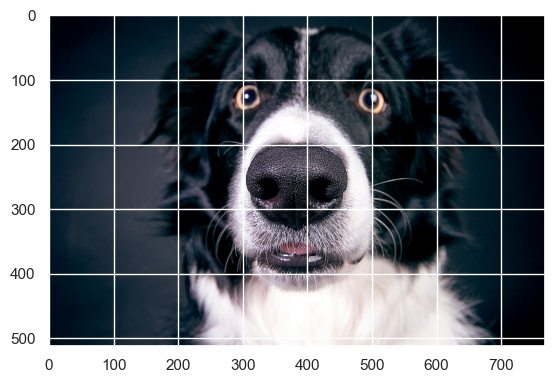

<Figure size 1000x1000 with 0 Axes>

dog
dog
horse
[ 3.1702013  8.046549  13.16946   68.95588    6.6579113]
[3 2]
['horse', 'elephant']


In [469]:
predic_2('test_animals/images1.jpg')
predic_2('test_animals/images2.jpg')
predic_2('test_animals/images3.jpg')
predic_2('test_animals/images4.jpg')
predic_2('test_animals/images5.jpg')
predic_2('test_animals/images6.jpg')
predic_2('test_animals/images7.jpg')
predic_2('test_animals/images8.jpg')
predic_2('test_animals/images9.jpg')
predic_2('test_animals/images10.jpg')
predic_2('test_animals/images11.jpg')
predic_2('test_animals/images12.jpg')
predic_2('test_animals/images13.jpg')
predic_2('test_animals/images15.jpg')
predic_2('test_animals/images16.jpg')
predic_2('test_animals/images17.jpg')
predic_2('test_animals/images18.jpg')
predic_2('test_animals/images19.jpg')
predic_2('test_animals/images20.jpg')
predic_2('test_animals/images21.jpg')
predic_2('test_animals/images22.jpg')
predic_2('test_animals/images23.jpg')
predic_2('test_animals/images24.jpg')
predic_2('test_animals/images25.jpg')

In [470]:
predict = []
def predic_1(A):
    img = tf.keras.utils.load_img(A, target_size = (150, 150))
    img_array = tf.keras.utils.img_to_array(img)
    img_array = tf.expand_dims(img_array, 0)

    predictions = model.predict(img_array)
    score = tf.nn.softmax(predictions[0])
    predict.append(class_names[np.argmax(score)])

    print(
        "This image most likely belongs to {} with a {:.2f} percent confidence."
        .format(class_names[np.argmax(score)], 100 * np.max(score))
    )
    
    imagen = plt.imread(A)
    plt.imshow(imagen)
    plt.figure(figsize=(10,10))
    plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
This image most likely belongs to dog with a 54.08 percent confidence.


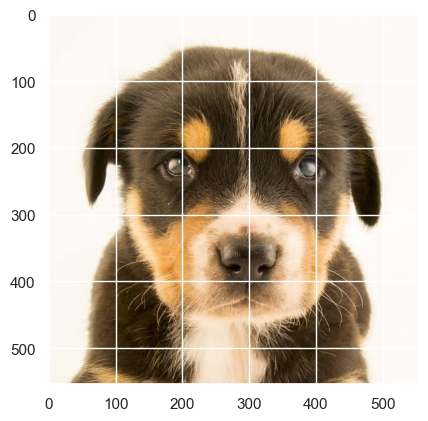

<Figure size 1000x1000 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
This image most likely belongs to cat with a 42.83 percent confidence.


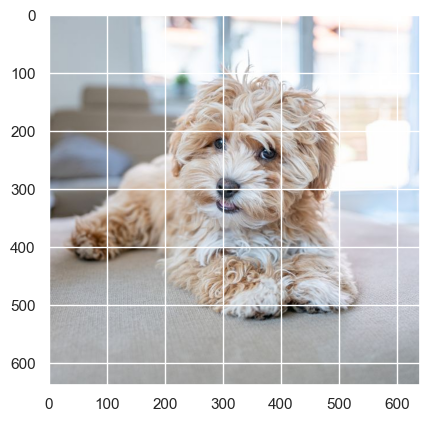

<Figure size 1000x1000 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to cat with a 99.62 percent confidence.


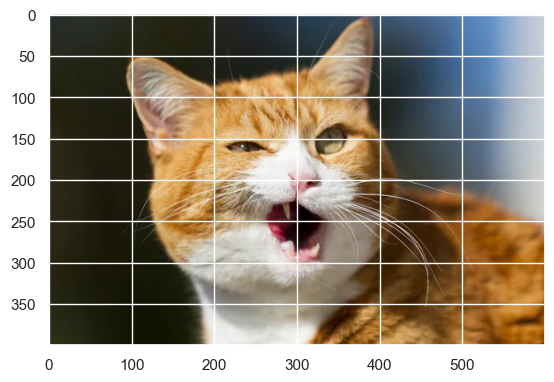

<Figure size 1000x1000 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
This image most likely belongs to lion with a 62.15 percent confidence.


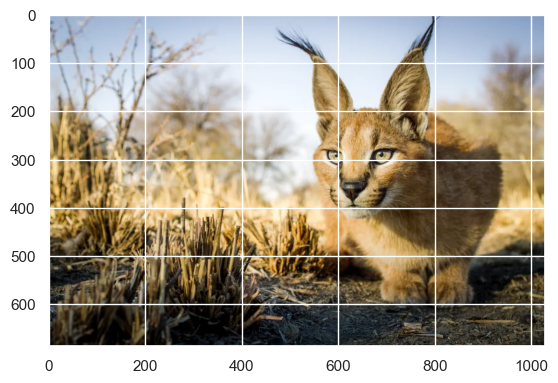

<Figure size 1000x1000 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to horse with a 91.09 percent confidence.


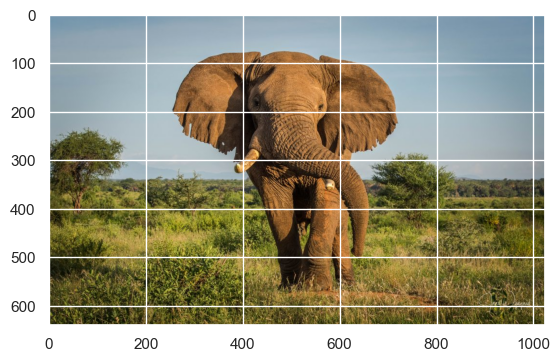

<Figure size 1000x1000 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to elephant with a 94.39 percent confidence.


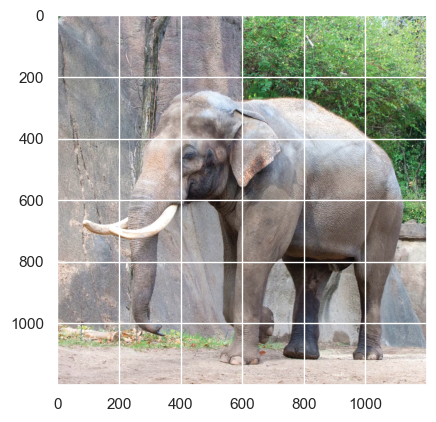

<Figure size 1000x1000 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to horse with a 48.27 percent confidence.


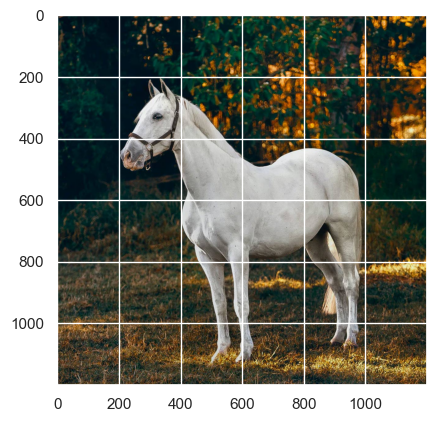

<Figure size 1000x1000 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to horse with a 99.89 percent confidence.


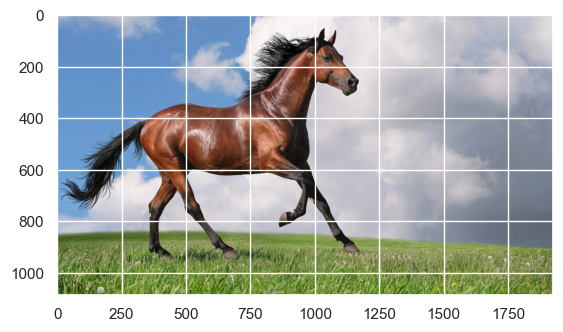

<Figure size 1000x1000 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to cat with a 76.93 percent confidence.


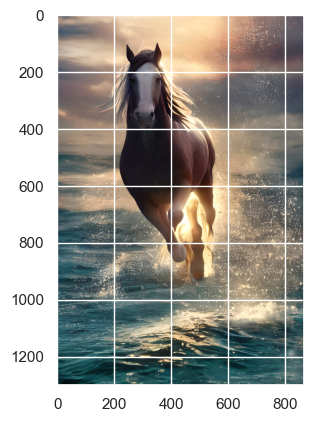

<Figure size 1000x1000 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
This image most likely belongs to lion with a 65.64 percent confidence.


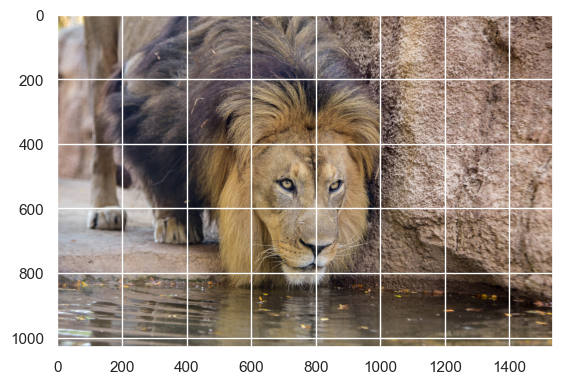

<Figure size 1000x1000 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to lion with a 95.88 percent confidence.


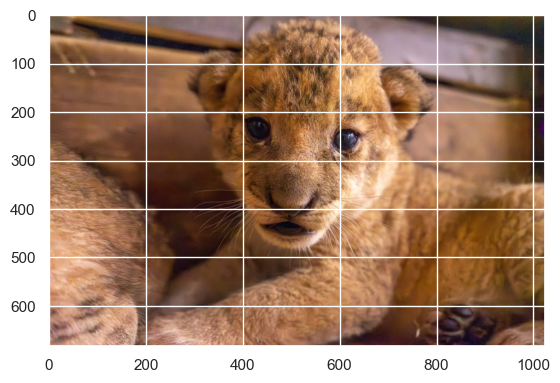

<Figure size 1000x1000 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to lion with a 98.56 percent confidence.


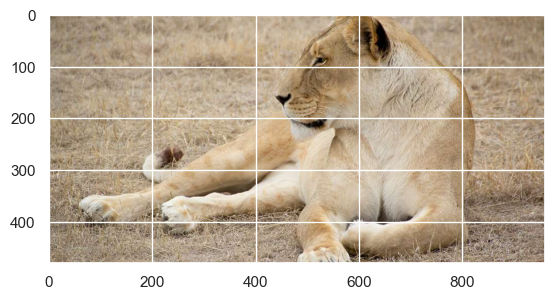

<Figure size 1000x1000 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to horse with a 60.24 percent confidence.


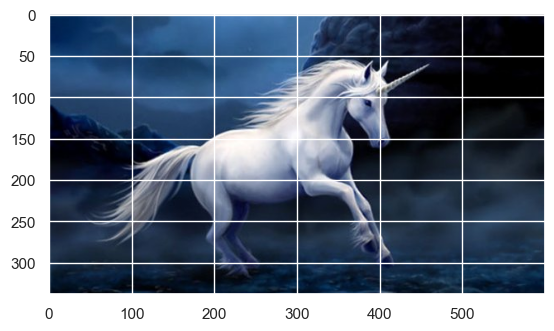

<Figure size 1000x1000 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to cat with a 56.32 percent confidence.


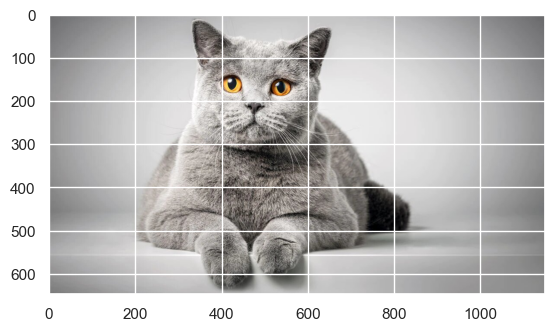

<Figure size 1000x1000 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
This image most likely belongs to cat with a 99.72 percent confidence.


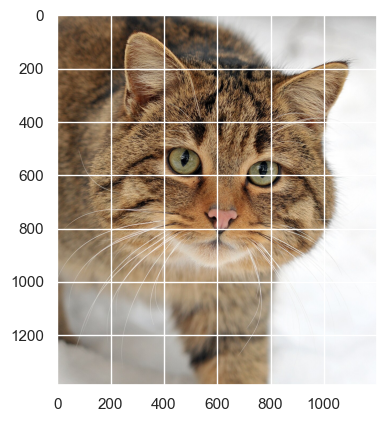

<Figure size 1000x1000 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to cat with a 99.17 percent confidence.


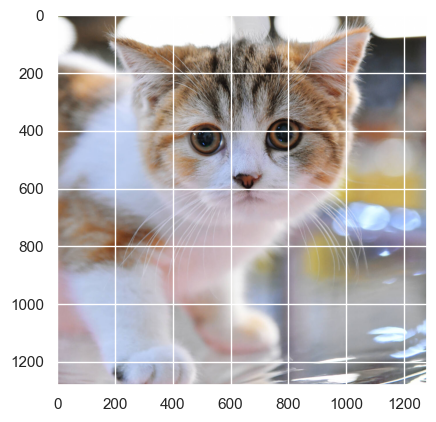

<Figure size 1000x1000 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to lion with a 73.88 percent confidence.


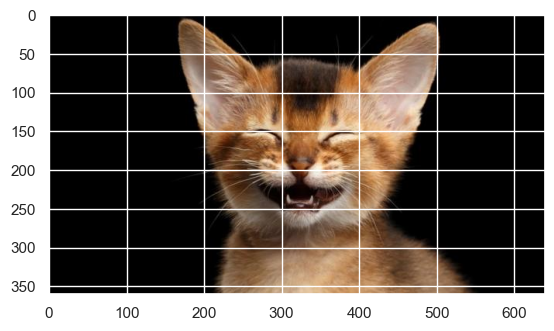

<Figure size 1000x1000 with 0 Axes>

In [471]:
predic_1('test_animals/images1.jpg')
predic_1('test_animals/images2.jpg')
predic_1('test_animals/images3.jpg')
predic_1('test_animals/images4.jpg')
predic_1('test_animals/images5.jpg')
predic_1('test_animals/images6.jpg')
predic_1('test_animals/images7.jpg')
predic_1('test_animals/images8.jpg')
predic_1('test_animals/images9.jpg')
predic_1('test_animals/images10.jpg')
predic_1('test_animals/images11.jpg')
predic_1('test_animals/images12.jpg')
predic_1('test_animals/images13.jpg')
predic_1('test_animals/images15.jpg')
predic_1('test_animals/images16.jpg')
predic_1('test_animals/images17.jpg')
predic_1('test_animals/images18.jpg')

In [472]:
correct = ["dog", "dog", "cat", "cat", "elephant","elephant","horse","horse",
           "horse","lion","lion","lion","horse", "cat", "cat", "cat", "cat"]
correct_answer = 0
for c, p in zip(correct, predict):
    if c == p:
        correct_answer += 1
    else:
        pass

porcentaje = correct_answer/len(correct) * 100

print(f"The model correctly predicted {porcentaje} of the given images")

The model correctly predicted 70.58823529411765 of the given images


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to elephant with a 95.19 percent confidence.


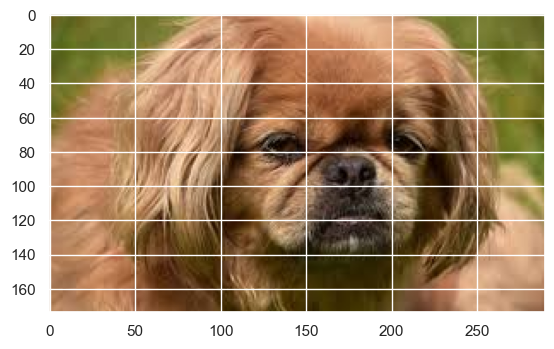

<Figure size 1000x1000 with 0 Axes>

dog
dog
elephant
[9.007929e-03 4.166225e-02 9.518581e+01 7.214392e-01 4.042073e+00]
[2 4]
['elephant', 'lion']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to dog with a 50.87 percent confidence.


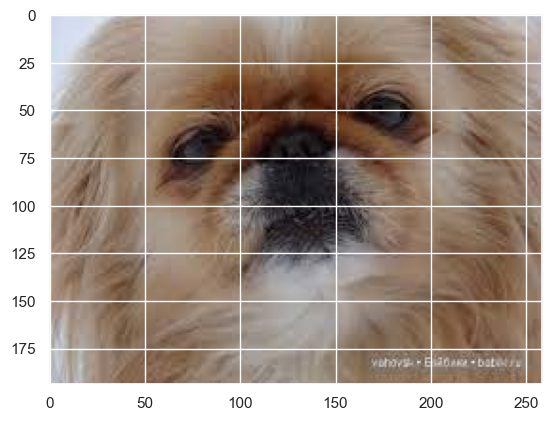

<Figure size 1000x1000 with 0 Axes>

dog
dog
dog
[17.831442  50.87031    2.0551147  4.132907  25.11023  ]
[1 4]
['dog', 'lion']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to horse with a 100.00 percent confidence.


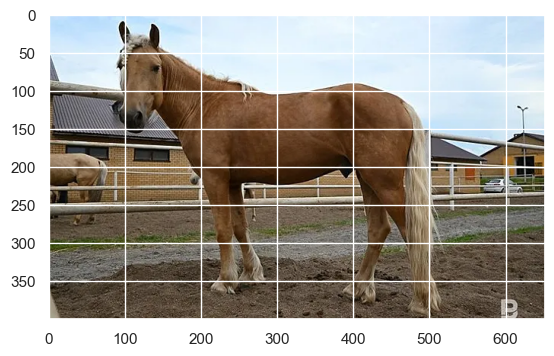

<Figure size 1000x1000 with 0 Axes>

dog
dog
horse
[3.8771950e-06 7.7753466e-05 3.8492191e-03 9.9995628e+01 4.4204027e-04]
[3 2]
['horse', 'elephant']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to horse with a 97.22 percent confidence.


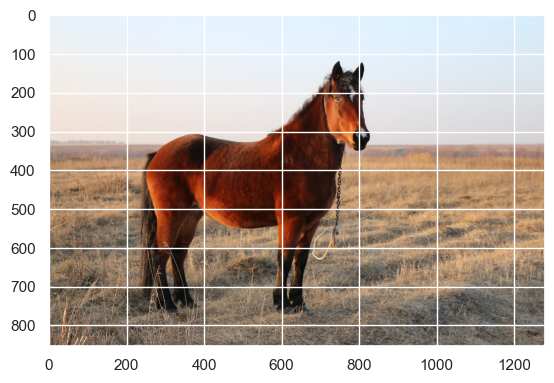

<Figure size 1000x1000 with 0 Axes>

dog
dog
horse
[ 0.113429    0.41890863  1.4359139  97.22025     0.8114864 ]
[3 2]
['horse', 'elephant']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
This image most likely belongs to horse with a 99.74 percent confidence.


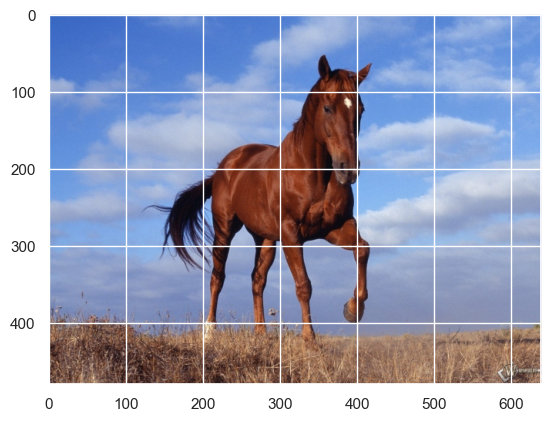

<Figure size 1000x1000 with 0 Axes>

dog
dog
horse
[6.8183790e-04 1.5959796e-02 2.2368279e-01 9.9738411e+01 2.1254851e-02]
[3 2]
['horse', 'elephant']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to cat with a 69.35 percent confidence.


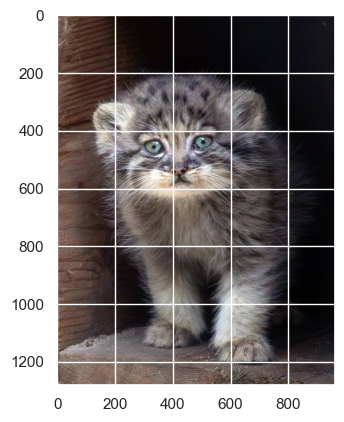

<Figure size 1000x1000 with 0 Axes>

dog
dog
cat
[69.35184   27.194155   0.1414245  0.4677362  2.844845 ]
[0 1]
['cat', 'dog']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
This image most likely belongs to elephant with a 91.76 percent confidence.


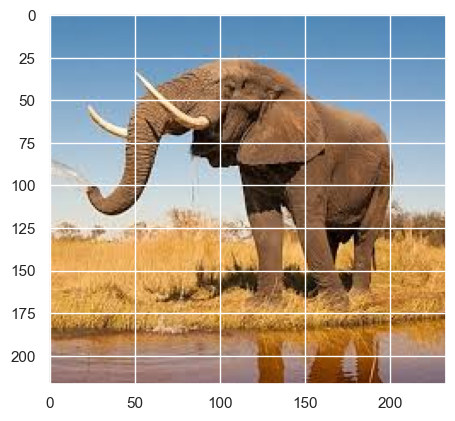

<Figure size 1000x1000 with 0 Axes>

dog
dog
elephant
[2.3062048e-05 2.2002393e-03 9.1764389e+01 7.9170413e+00 3.1635350e-01]
[2 3]
['elephant', 'horse']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
This image most likely belongs to elephant with a 95.68 percent confidence.


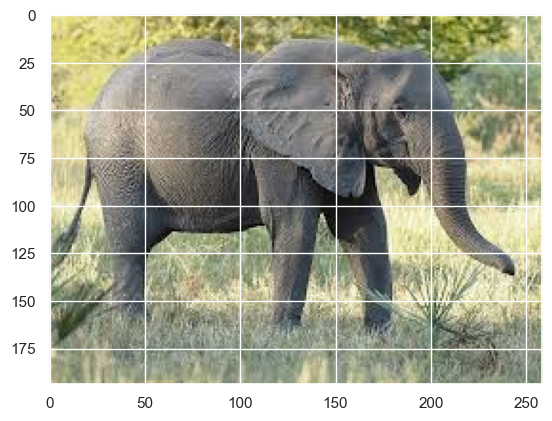

<Figure size 1000x1000 with 0 Axes>

dog
dog
elephant
[8.7235473e-02 3.3464524e-01 9.5683006e+01 2.8303838e+00 1.0647206e+00]
[2 3]
['elephant', 'horse']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
This image most likely belongs to horse with a 99.84 percent confidence.


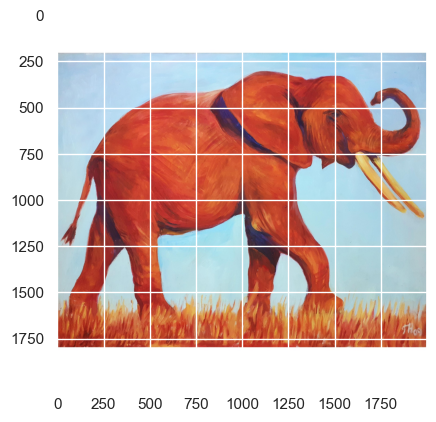

<Figure size 1000x1000 with 0 Axes>

dog
dog
horse
[4.1404975e-04 4.7548814e-03 9.6143998e-02 9.9840744e+01 5.7949107e-02]
[3 2]
['horse', 'elephant']


In [473]:
predic_2('test_animals/images26.jpg')
predic_2('test_animals/images27.jpg')
predic_2('test_animals/images28.jpg')
predic_2('test_animals/images29.jpg')
predic_2('test_animals/images30.jpg')
predic_2('test_animals/images31.jpg')
predic_2('test_animals/images32.jpg')
predic_2('test_animals/images33.jpg')
predic_2('test_animals/images34.jpg')